# imports stuff!

In [1]:
!pip install -q pytorch-lightning

     |████████████████████████████████| 706 kB 9.0 MB/s 
     |████████████████████████████████| 5.9 MB 32.8 MB/s 
     |████████████████████████████████| 419 kB 47.8 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [2]:
import os
from glob import glob
from pathlib import Path
import datetime
import random
import math

import matplotlib.pyplot as plt
from PIL import Image

import numpy as np
import skimage
import skimage.metrics

import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms.functional import center_crop
from torchvision.utils import make_grid
from tqdm.auto import tqdm

import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint

In [3]:
# Set random seed for reproducibility
seed = 14383421    # with apologies to the funyarinpa
dataset_split_seed = 1797147     # with apologies to myself
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  14383421


## Retrieve dataset from google drive

In [4]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive')

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


In [5]:
%%bash

# copying stuff to the colab vm
echo "Making dirs"
mkdir realblur
echo "Decompressing archive"
tar -xf /content/drive/MyDrive/realblur.tar.gz -C realblur

Making dirs
Decompressing archive


# Dataset

Some data augmentations that will be used by the dataset

In [6]:
# essential not only for augmentation, but to enforce the correct size as well
# assumes both images are the same shape
def random_crop(img_pair, cropped_size):
    first, second = img_pair

    # -1 is only for irrational safety
    umax = first.shape[1] - cropped_size - 1
    vmax = first.shape[2] - cropped_size - 1

    u = random.randint(0, umax)
    v = random.randint(0, vmax)

    # random crop
    first = first[:, u:u+cropped_size, v:v+cropped_size]
    second = second[:, u:u+cropped_size, v:v+cropped_size]

    return first, second

And then proper data classes

In [7]:
class RealBlurDataset(Dataset):
  def __init__(self, target_size=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    self.target_size = target_size
    self.mean = mean
    self.std = std

    self._base_dir = "realblur/"
    train_file = self._base_dir + "RealBlur_J_Tele_test_list.txt"
    self._data_path = []
    with open(train_file, "r") as f:
      for line in f.readlines():
        s = line.split(" ")
        self._data_path.append([f"{self._base_dir}/{s[0]}", f"{self._base_dir}/{s[1]}"])
      f.close()

  def __getitem__(self, index):
    real = Image.open(self._data_path[index % len(self._data_path)][0])
    blurred = Image.open(self._data_path[index % len(self._data_path)][1])

    real = transforms.functional.to_tensor(real)
    blurred = transforms.functional.to_tensor(blurred)

    real = transforms.functional.normalize(real, self.mean, self.std)
    blurred = transforms.functional.normalize(blurred, self.mean, self.std)

    target_size = self.target_size
    if target_size:
      # crop for target size
      real, blurred = random_crop((real, blurred), target_size)


    return real, blurred

  def __len__(self):
    return len(self._data_path)

Also make a DataModule to handle train/test split *(so we can evaluate the metrics on a different set)*

In [8]:
class BSD_B_DataModule(pl.LightningDataModule):
    def __init__(
            self,
            batch_size,
            target_size=None,
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            val_split=-1,       # *_split in [0,1]. Both express a part of the full dataset.
            test_split=-1,
            shuffle=True
    ):
        super().__init__()
        self.batch_size = batch_size
        self.target_size = target_size
        self.mean = mean
        self.std = std
        self.val_split = val_split
        self.test_split = test_split
        self.shuffle = shuffle
    
    def prepare_data(self):
        pass   # no download!
    
    def setup(self, stage=None):    # stage is unused here, load the whole dataset
        bsd_full = RealBlurDataset(target_size=target_size, mean=self.mean, std=self.std)

        if self.test_split > 0:
            test_samples = int(math.floor( len(bsd_full) * self.test_split ))
            bsd_trainval, self.bsd_test = torch.utils.data.random_split(bsd_full, [len(bsd_full) - test_samples, test_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            bsd_trainval, self.bsd_test = bsd_full, None
        
        if self.val_split > 0:
            val_samples = int(math.floor( len(bsd_full) * self.val_split ))   # both splits are expressed on the full dataset
            self.bsd_train, self.bds_val = torch.utils.data.random_split(bsd_trainval, [len(bsd_trainval) - val_samples, val_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            self.bsd_train, self.bsd_val = bsd_trainval, None
    
    def train_dataloader(self):
        return DataLoader(self.bsd_train, batch_size=self.batch_size, shuffle=self.shuffle)
    
    def val_dataloader(self):
        if self.bsd_val != None:
            return DataLoader(self.bsd_val, batch_size=self.batch_size)
        else:
            return []
    
    def test_dataloader(self):
        if self.bsd_test != None:
            return DataLoader(self.bsd_test, batch_size=self.batch_size)
        else:
            return []

# testing this cell...
# TODO remove
d = BSD_B_DataModule(32)

# Networks

## Generator

Traditional convolution (i.e. encoder) block, combines the actual conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will halve the image's width/height at each layer.

In [9]:
class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=5, stride=2, padding=2, use_activation=True, use_batchnorm=True):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.conv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        return x

Transpose convolution (i.e. decoder) block, combines the actual t.conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will double the image's width/height at each layer.

In [10]:
class ConvTranspBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, use_activation=True, use_batchnorm=True, use_dropout=False):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm
        self.use_dropout = use_dropout

        self.tconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

        if use_dropout:
            self.drop = nn.Dropout2d(0.5)

    def forward(self, x):
        x = self.tconv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        if self.use_dropout:
            x = self.drop(x)
        return x

In [11]:
class ResnetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=5):
        super().__init__()
        padding = kernel_size // 2
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)

        self.bn1 = nn.BatchNorm2d(out_channels)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, input):
        output = nn.ReLU()(self.bn1(self.conv1(input)))
        output = nn.ReLU()(self.bn2(self.conv2(output)))
        input = input + output
        return nn.ReLU()(input)

In [12]:
class ConvLSTMCell(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTMCell, self).__init__()  

        if activation == "tanh":
            self.activation = torch.tanh 
        elif activation == "relu":
            self.activation = torch.relu
        
        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        self.conv = nn.Conv2d(
            in_channels=in_channels + out_channels, 
            out_channels=4 * out_channels, 
            kernel_size=kernel_size, 
            padding=padding)           

        # Initialize weights for Hadamard Products
        self.W_ci = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_co = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_cf = nn.Parameter(torch.Tensor(out_channels, *frame_size))

    def forward(self, X, H_prev, C_prev):

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        conv_output = self.conv(torch.cat([X, H_prev], dim=1))

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        i_conv, f_conv, C_conv, o_conv = torch.chunk(conv_output, chunks=4, dim=1)

        input_gate = torch.sigmoid(i_conv + self.W_ci * C_prev )
        forget_gate = torch.sigmoid(f_conv + self.W_cf * C_prev )

        # Current Cell output
        C = forget_gate*C_prev + input_gate * self.activation(C_conv)

        output_gate = torch.sigmoid(o_conv + self.W_co * C )

        # Current Hidden State
        H = output_gate * self.activation(C)

        return H, C

class ConvLSTM(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTM, self).__init__()

        self.out_channels = out_channels

        # We will unroll this over time steps
        self.convLSTMcell = ConvLSTMCell(in_channels, out_channels, kernel_size, padding, activation, frame_size)

    def forward(self, X, state):

        # X is a frame sequence (batch_size, num_channels, seq_len, height, width)

        # Get the dimensions
        batch_size, _, height, width = X.size()

        # Initialize output
        output = torch.zeros(batch_size, self.out_channels, 1, height, width).cuda()
        
        if state is None:
            # Initialize Hidden State
            H = torch.zeros(batch_size, self.out_channels, height, width)
            # Initialize Cell Input
            C = torch.zeros(batch_size,self.out_channels, height, width)
        else:
            H, C = state
            H = transforms.Resize((height, width))(H)
            C = transforms.Resize((height, width))(C)
        
        H, C = H.cuda(), C.cuda()

        H, C = self.convLSTMcell(X, H, C)

        H, C = H.cuda(), C.cuda()

        return H, (H, C)

In [13]:
class Generator(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.scale = [.25, .5, 1]

         # create the layers of the "encoder" half of the generator
        self.preLSTM = nn.ModuleList([
            ConvBlock(in_channels*2, 32, stride=1, padding=1, use_batchnorm=False),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvBlock(64, 128, use_batchnorm=False),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128)
        ])
        self.postLSTM = nn.ModuleList([
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ConvTranspBlock(128, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvTranspBlock(64, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, out_channels, kernel_size=5, stride=1, padding=2, use_activation=False)
        ])

        lstmBlock = lambda size: ConvLSTM(128, 128, 5, 2, "relu", size)
        self.lstmBlocks = nn.ModuleList([
            lstmBlock((16, 16)),
            lstmBlock((32, 32)),
            lstmBlock((64, 64))
        ])

        self.final_act = nn.Tanh()


    def forward(self, input):
        _, _, h, w = input.shape

        rnn_state = None

        inp_pred = input

        for i in range(len(self.scale)):
            scale = self.scale[i]
            hi = int(round(h * scale))
            wi = int(round(w * scale))

            # Original of the paper, concat of the two images
            inp_blur = transforms.Resize((hi, wi))(input)
            inp_pred = transforms.Resize((hi, wi))(inp_pred).detach()
            output = torch.cat([inp_blur, inp_pred], dim=1)
            # Simpler version
            # output = transforms.Resize((hi, wi))(input)

            lstm = self.lstmBlocks[i]

            for pre in self.preLSTM:
                output = pre(output)
            output, rnn_state = lstm(output, rnn_state)
            for post in self.postLSTM:
                output = post(output)
            output = self.final_act(output)
            inp_pred = output

        return output

## Discriminator (PatchGAN)

In [14]:
class PatchGAN(nn.Module):

    def __init__(self, input_channels):
        super().__init__()
        self.conv1 = ConvBlock(input_channels, 64, use_batchnorm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512)
        self.final = nn.Conv2d(512, 1, kernel_size=1)

    def forward(self, x, y):
        x = torch.cat([x, y], axis=1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.final(x)
        return x

## Full GAN

*(some utils first)*

In [15]:
# https://stackoverflow.com/questions/49433936/how-to-initialize-weights-in-pytorch

# randomize initial weights by a normal distribution
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# shows blurred input, real original image, and generator output side by side for qualitative comparison.
# also takes care of converting from torch tensor (potentially) in the GPU to visualizable images.
def show_images_sidebyside(cond, fake, real, denormalization, figsize=(10,5)):
    cond = denormalization(cond)
    fake = denormalization(fake)
    real = denormalization(real)

    cond = cond.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    ax[0].imshow(cond)
    ax[2].imshow(fake)
    ax[1].imshow(real)
    plt.show()

# invert normalization to visualize.
# explained here: https://discuss.pytorch.org/t/simple-way-to-inverse-transform-normalization/4821/4
def denormalize(img, mean, std):
    mean_r, mean_g, mean_b = mean
    std_r, std_g, std_b = std
    return transforms.functional.normalize(
        img,
        [-mean_r/std_r, -mean_g/std_g, -mean_b/std_b],
        [      1/std_r,       1/std_g,       1/std_b]
    )

def denormalize_factory(the_mean, the_std):
    return lambda img: denormalize(img, the_mean, the_std)

Two losses: Adversarial l. to make realistic images in general, Reconstruction l. to produce an image near to the conditioning img.

In [16]:
class Pix2Pix(pl.LightningModule):

    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_recon=100, display_step=25, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):

        super().__init__()
        self.save_hyperparameters()     # This Lightning black magic saves all the parameters of __init__ without us telling it anything. Not sure how it's possible, but it is.
        
        self.display_step = display_step
        self.gen = Generator(in_channels, out_channels)
        self.discr = PatchGAN(in_channels + out_channels)

        # init weights
        self.gen = self.gen.apply(_weights_init)
        self.discr = self.discr.apply(_weights_init)

        # loss functions
        self.advers_criterion = nn.BCEWithLogitsLoss()
        self.recon_criterion = nn.L1Loss()

    def _gen_step(self, real_images, conditioning_images):
        # Generate!
        fake_images = self.gen(conditioning_images)

        # Calc adversarial loss...
        disc_logits = self.discr(fake_images, conditioning_images)
        adversarial_loss = self.advers_criterion(disc_logits, torch.ones_like(disc_logits))   # set groundtruth as "real" when training gen

        # ...then reconstruction loss...
        recon_loss = self.recon_criterion(fake_images, real_images)

        # ...finally combine with scale factor
        lambda_recon = self.hparams.lambda_recon
        return adversarial_loss + lambda_recon * recon_loss

    def _discr_step(self, real_images, conditioning_images):
        # Generate! (and don't do gradient)
        fake_images = self.gen(conditioning_images).detach()

        # Discriminate
        fake_logits = self.discr(fake_images, conditioning_images)
        real_logits = self.discr(real_images, conditioning_images)

        # Calc. classif. loss
        fake_loss = self.advers_criterion(fake_logits, torch.zeros_like(fake_logits))
        real_loss = self.advers_criterion(real_logits, torch.ones_like(real_logits))

        # as standard as expected
        return (real_loss + fake_loss) / 2

    def configure_optimizers(self):
        lr = self.hparams.learning_rate
        gen_opt = torch.optim.Adam(self.gen.parameters(), lr=lr)
        discr_opt = torch.optim.Adam(self.discr.parameters(), lr=lr)
        return discr_opt, gen_opt

    def training_step(self, batch, batch_idx, optimizer_idx):
        real, conditioning = batch

        # Step and log loss
        loss = None
        if optimizer_idx == 0:
            loss = self._discr_step(real, conditioning)
            self.log('PatchGAN Loss', loss)
        elif optimizer_idx == 1:
            loss = self._gen_step(real, conditioning)
            self.log('Generator Loss', loss)
        
        # show example images from time to time to qualitatively show some progress
        if self.current_epoch % self.display_step == 0 and batch_idx == 0 and optimizer_idx == 1:
            fake = self.gen(conditioning).detach()
            the_denormalize = denormalize_factory(self.hparams.mean, self.hparams.std)
            real0_for_psnr = the_denormalize(real[0]).cpu().numpy()
            fake0_for_psnr = the_denormalize(fake[0]).cpu().numpy()
            true_min, true_max = np.min(real0_for_psnr), np.max(real0_for_psnr)
            print("----", true_min, ",,", true_max)
            psnr = skimage.metrics.peak_signal_noise_ratio(
                real0_for_psnr,
                fake0_for_psnr
            )
            print("=====")
            print("This is epoch", self.current_epoch)
            print("And the PSNR is", psnr)
            print("And the images are...")
            show_images_sidebyside(conditioning[0], fake[0], real[0], lambda x:x)    # per ora voglio vedere sia normalizzate che denormalizzate
            show_images_sidebyside(conditioning[0], fake[0], real[0], the_denormalize)
        return loss

# Training!

## Parameters

In [17]:
# mean and standard deviation for normalization, calcuated manually over the dataset una-tantum.
# the code is in another notebook.
mean = [0.4355969288502789, 0.43763443105665034, 0.3649651865988699]
std = [0.23582929701856753, 0.2207150368759555, 0.23132070247996644]

lambda_recon = 100

n_epochs = 2000

display_step = 1
batch_size = 4
lr = 0.0002
target_size = 256

isodate = datetime.date.today().isoformat().replace("-", "")   # example: "20220624"
checkpoint_callback = ModelCheckpoint(
    save_top_k = -1, # i.e. save all, as per doc
    every_n_epochs = 4,
    save_on_train_epoch_end = True,
    dirpath = "/content/drive/MyDrive/VP/Checkpoints",
    filename = "ckpt-pix2pix-"+isodate+"-{epoch:02d}",
)

# some times...
# up to epoch 9 in 2h 50 min, w/ batch_size=4 and GPU

# Tensorboard

In [18]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

# Let's-a go

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is deprecated in v1.7 and will be removed"
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:115: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dis

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/core/module.py:555: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  value = torch.tensor(value, device=self.device)


---- 0.003921544 ,, 0.97254896
=====
This is epoch 0
And the PSNR is 11.33789669127028
And the images are...


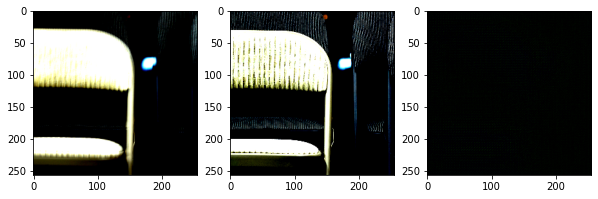

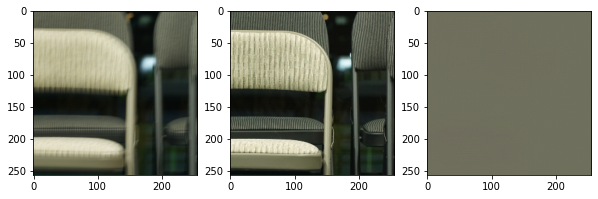

---- 0.0 ,, 1.0
=====
This is epoch 1
And the PSNR is 13.18409506959922
And the images are...


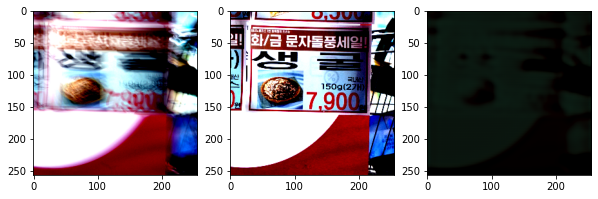

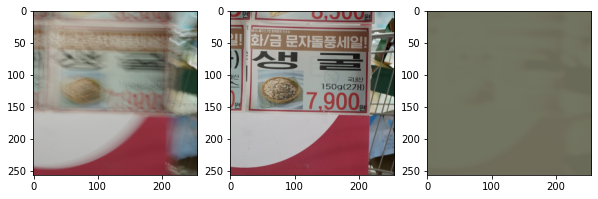

---- 0.015686255 ,, 0.7921568
=====
This is epoch 2
And the PSNR is 15.69568302258144
And the images are...


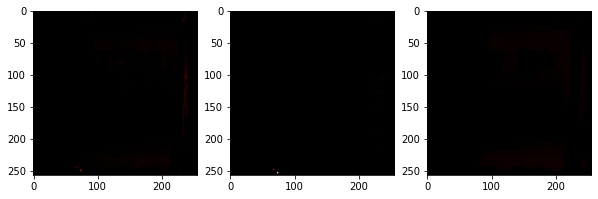

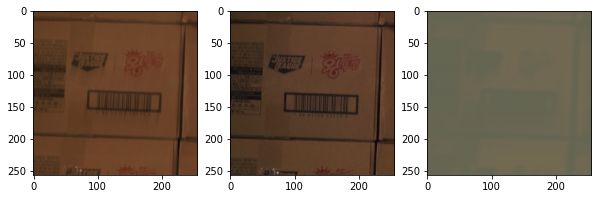

---- 0.027450956 ,, 0.92549014
=====
This is epoch 3
And the PSNR is 15.632227125605668
And the images are...


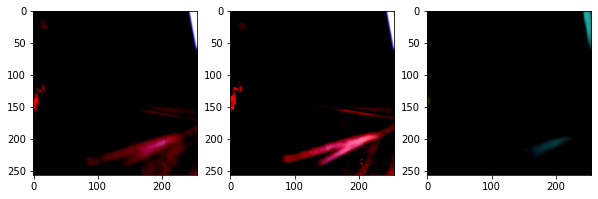

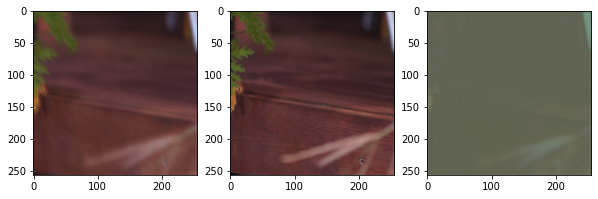

---- 0.0 ,, 0.9568627
=====
This is epoch 4
And the PSNR is 10.504881282630233
And the images are...


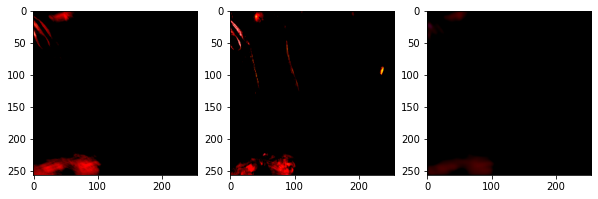

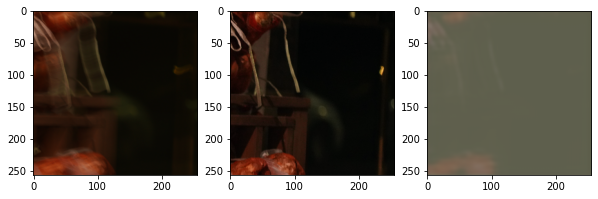

---- 0.0 ,, 0.98823524
=====
This is epoch 5
And the PSNR is 12.775216911498426
And the images are...


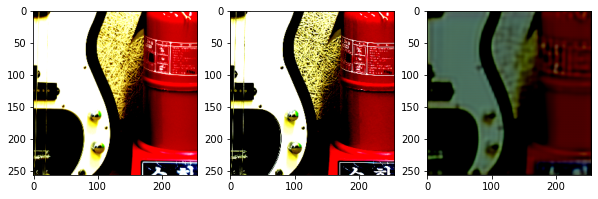

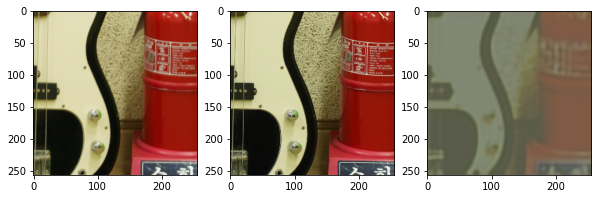

---- -2.811304e-08 ,, 1.0
=====
This is epoch 6
And the PSNR is 17.19434486516051
And the images are...


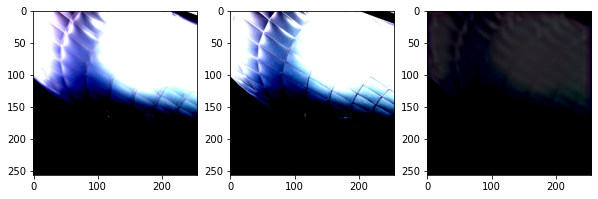

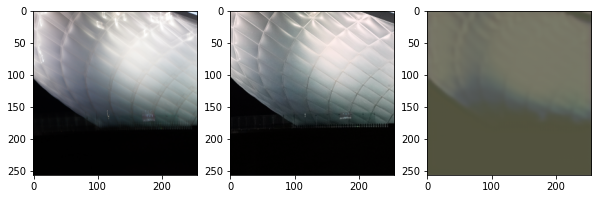

---- 0.0 ,, 0.90588224
=====
This is epoch 7
And the PSNR is 14.881738808072207
And the images are...


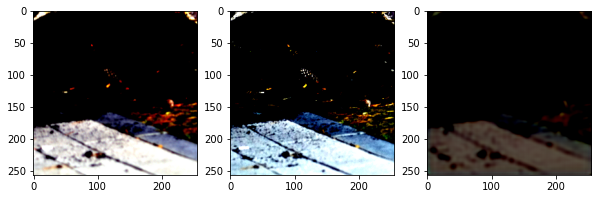

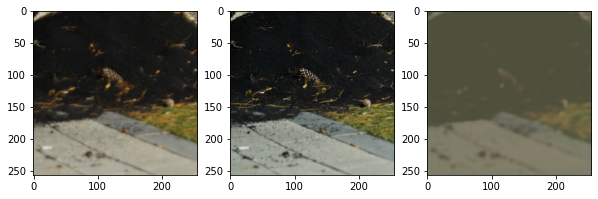

---- -2.811304e-08 ,, 0.9960784
=====
This is epoch 8
And the PSNR is 21.5653964139862
And the images are...


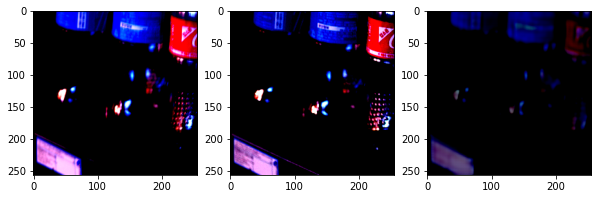

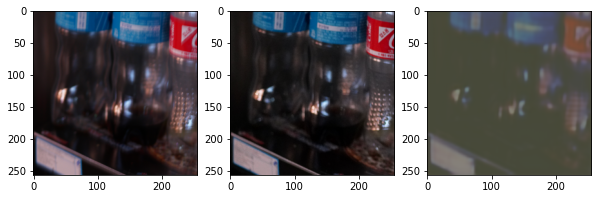

---- -2.811304e-08 ,, 0.6980392
=====
This is epoch 9
And the PSNR is 21.19019801828509
And the images are...


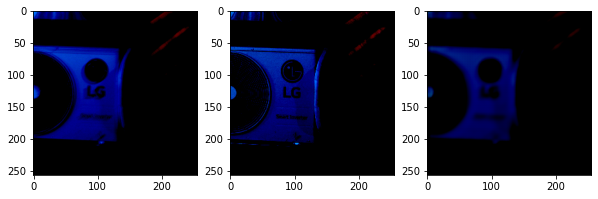

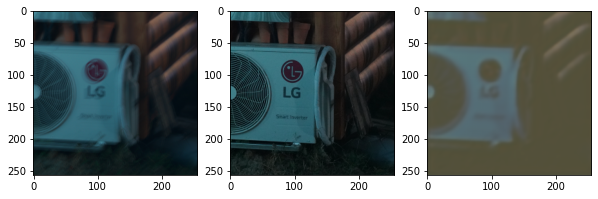

---- 0.058823504 ,, 0.7568627
=====
This is epoch 10
And the PSNR is 17.358269096470206
And the images are...


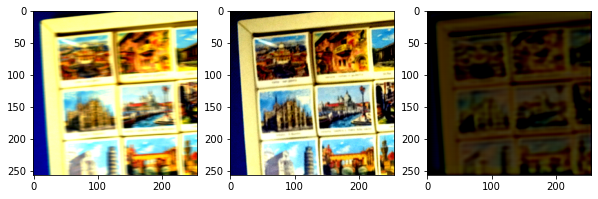

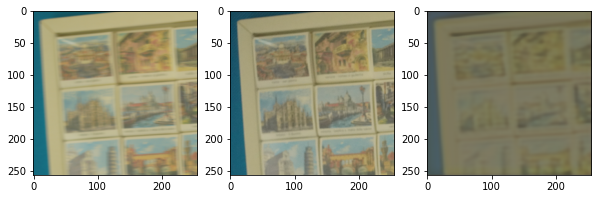

---- 0.03137254 ,, 0.98823524
=====
This is epoch 11
And the PSNR is 19.215913742599792
And the images are...


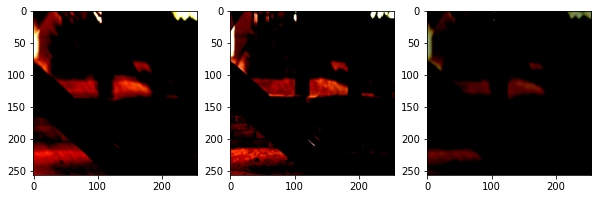

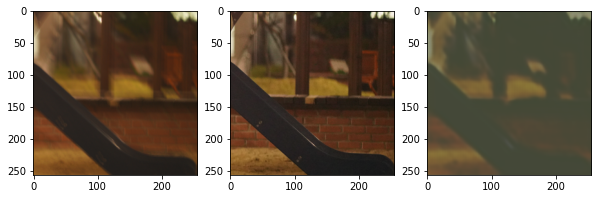

---- -2.811304e-08 ,, 0.7686274
=====
This is epoch 12
And the PSNR is 25.96159469103069
And the images are...


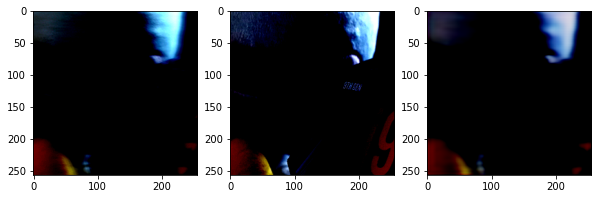

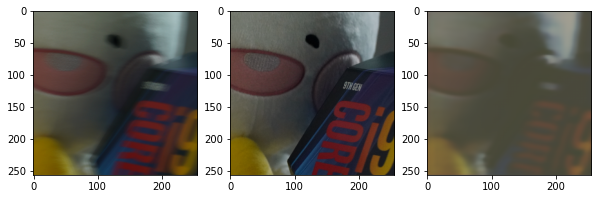

---- -2.811304e-08 ,, 0.980392
=====
This is epoch 13
And the PSNR is 22.487826421378458
And the images are...


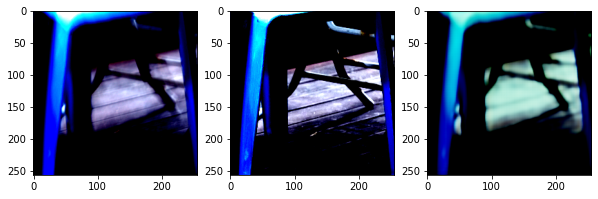

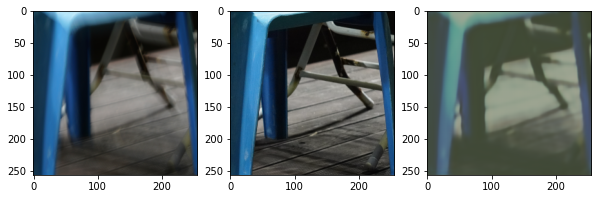

---- -2.6311284e-08 ,, 0.890196
=====
This is epoch 14
And the PSNR is 22.271701167026578
And the images are...


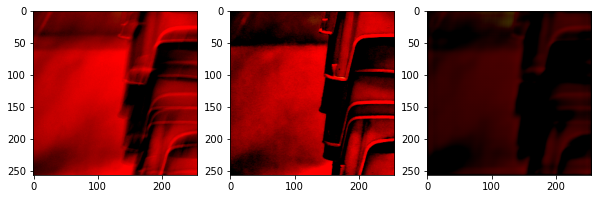

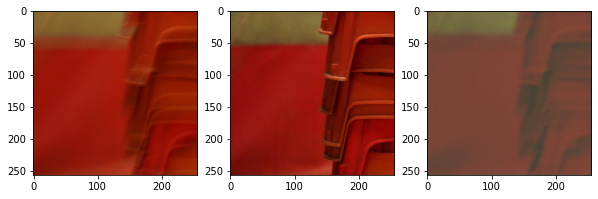

---- 0.02352941 ,, 0.54509807
=====
This is epoch 15
And the PSNR is 24.530771246734826
And the images are...


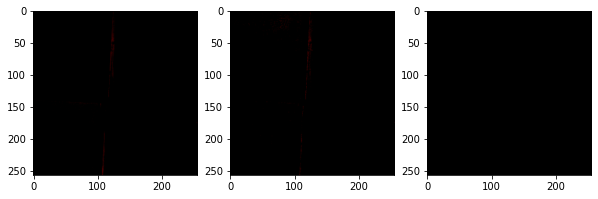

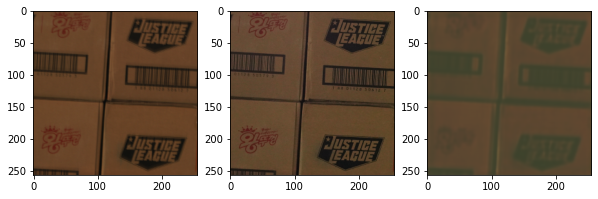

---- -2.811304e-08 ,, 1.0
=====
This is epoch 16
And the PSNR is 18.519523403520694
And the images are...


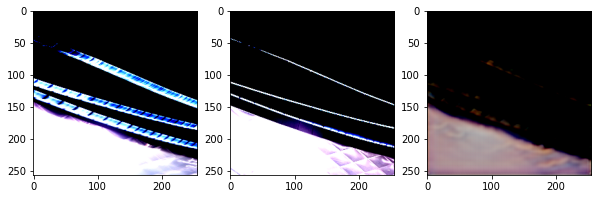

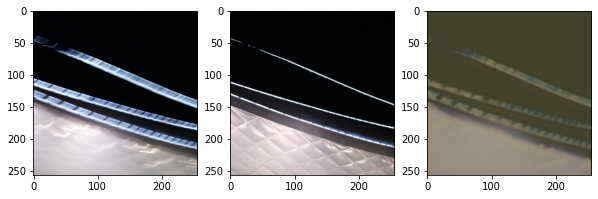

---- 0.0078431275 ,, 0.82745093
=====
This is epoch 17
And the PSNR is 20.685763115853565
And the images are...


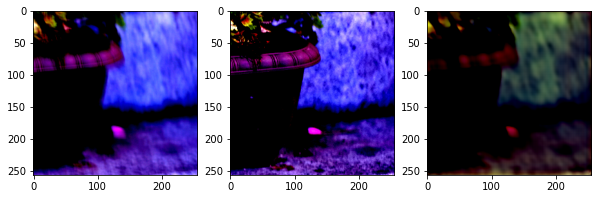

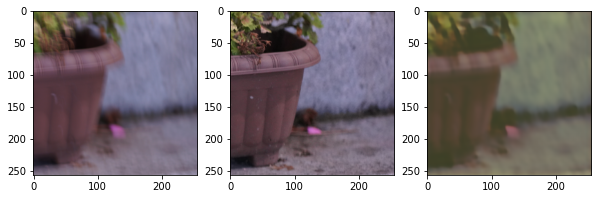

---- -2.811304e-08 ,, 0.8000001
=====
This is epoch 18
And the PSNR is 26.122295570853822
And the images are...


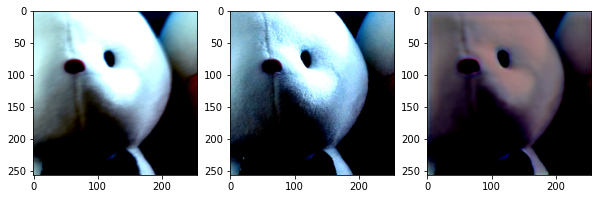

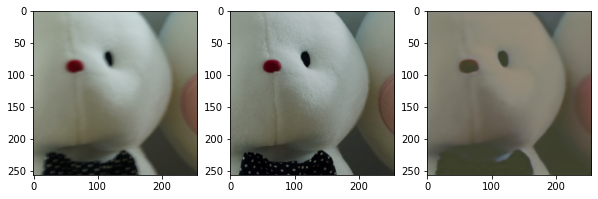

---- 0.0 ,, 0.9921568
=====
This is epoch 19
And the PSNR is 17.758875264116845
And the images are...


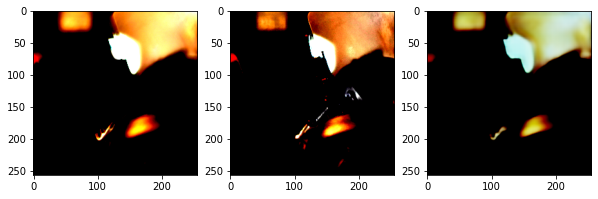

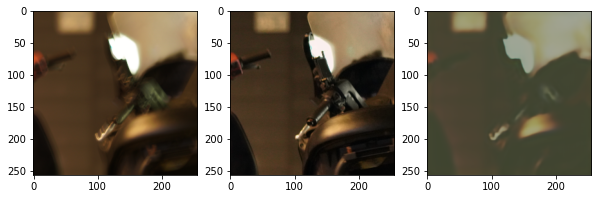

---- 0.0 ,, 0.83529407
=====
This is epoch 20
And the PSNR is 21.452614282085506
And the images are...


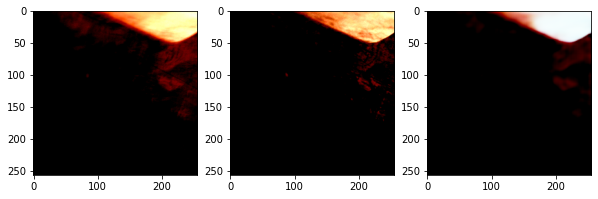

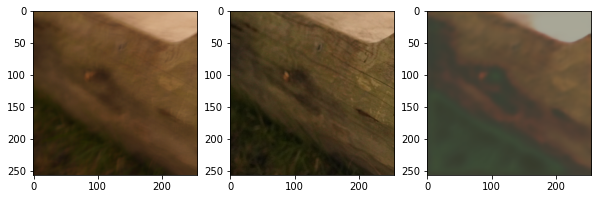

---- 0.027450962 ,, 0.717647
=====
This is epoch 21
And the PSNR is 24.050616946242087
And the images are...


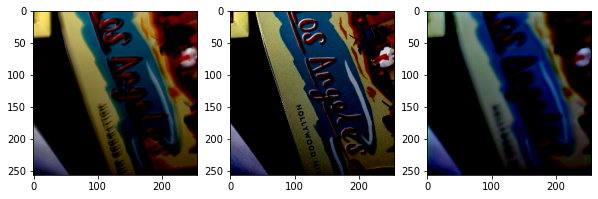

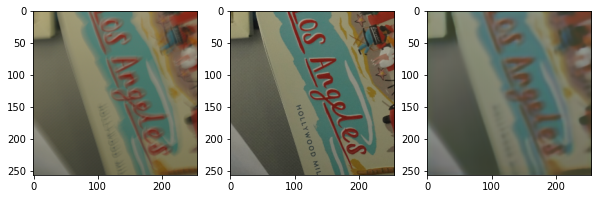

---- 0.0078431275 ,, 0.6196078
=====
This is epoch 22
And the PSNR is 20.719805801454353
And the images are...


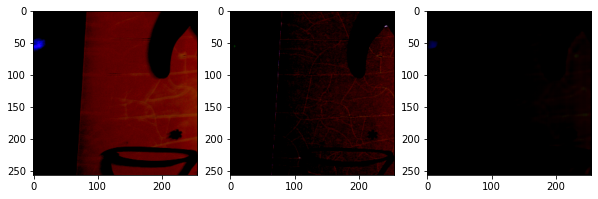

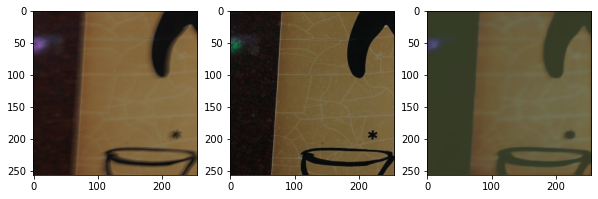

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 23
And the PSNR is 21.454775104461973
And the images are...


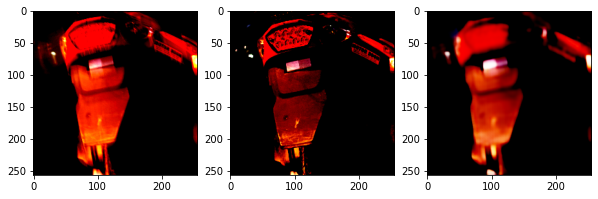

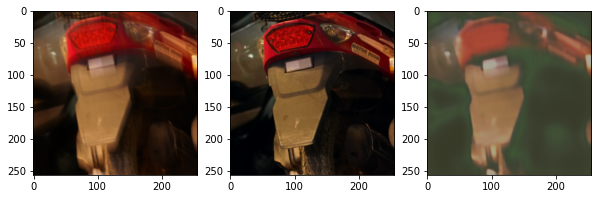

---- 0.0039215502 ,, 0.917647
=====
This is epoch 24
And the PSNR is 22.24471027226159
And the images are...


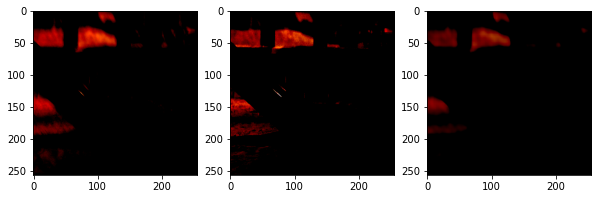

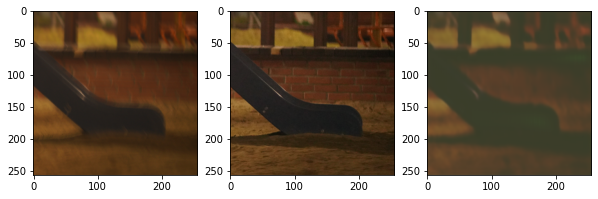

---- 0.015686262 ,, 0.9647058
=====
This is epoch 25
And the PSNR is 13.949657760133594
And the images are...


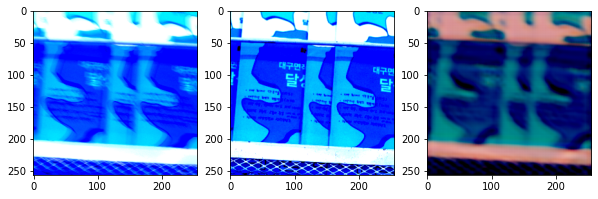

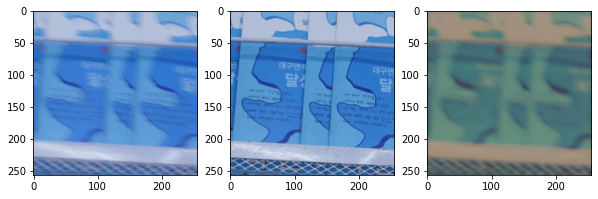

---- 0.0 ,, 1.0
=====
This is epoch 26
And the PSNR is 16.50008020741389
And the images are...


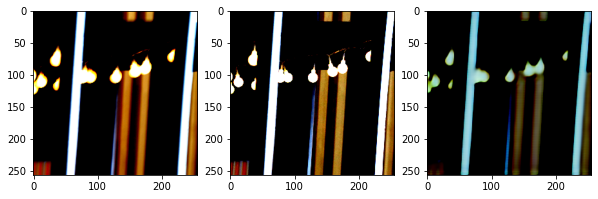

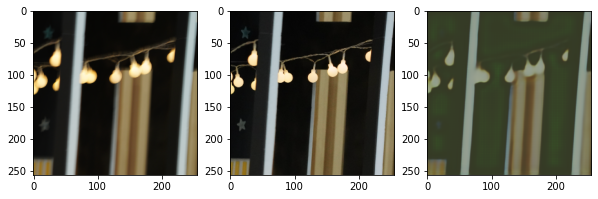

---- 0.02352941 ,, 0.9686274
=====
This is epoch 27
And the PSNR is 21.008051678486876
And the images are...


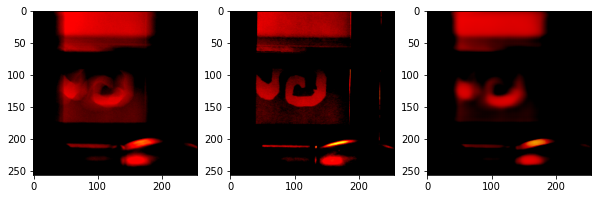

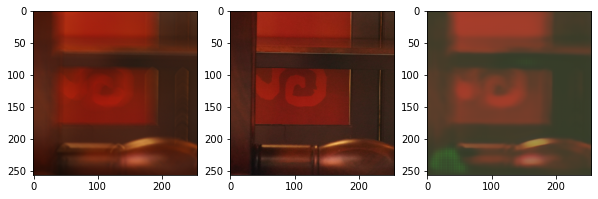

---- -2.811304e-08 ,, 1.0
=====
This is epoch 28
And the PSNR is 24.90176438822745
And the images are...


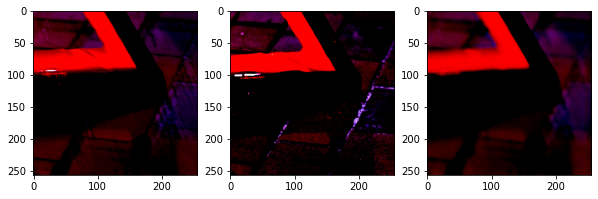

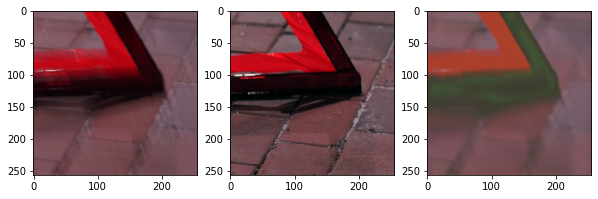

---- 0.007843117 ,, 0.917647
=====
This is epoch 29
And the PSNR is 21.301224957891662
And the images are...


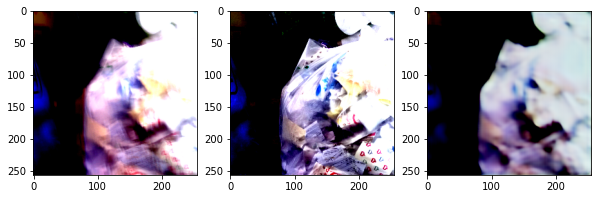

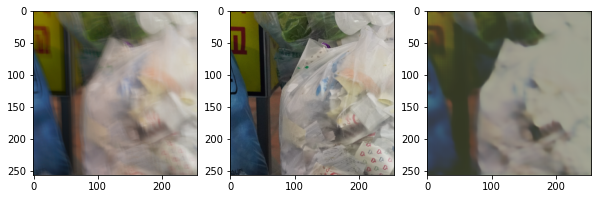

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 30
And the PSNR is 23.131398817669414
And the images are...


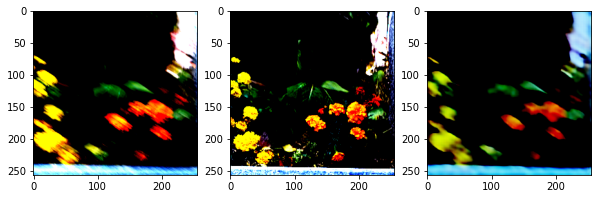

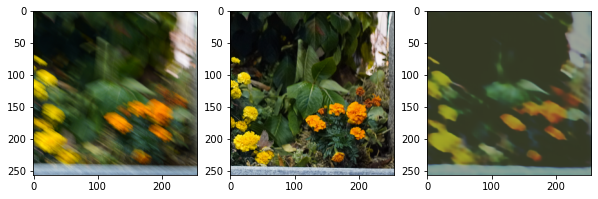

---- -2.811304e-08 ,, 0.98431367
=====
This is epoch 31
And the PSNR is 19.722585821540175
And the images are...


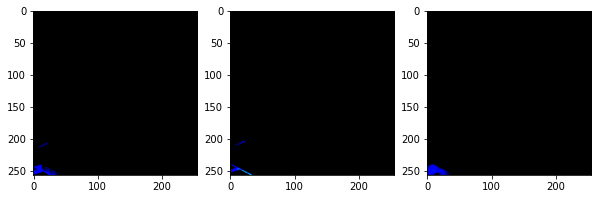

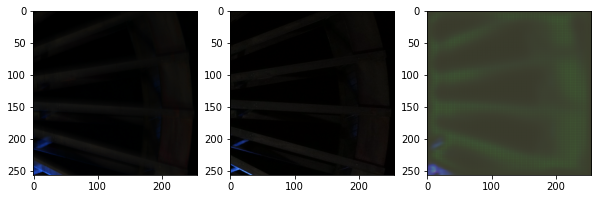

---- 0.0 ,, 0.89411765
=====
This is epoch 32
And the PSNR is 22.09447659787989
And the images are...


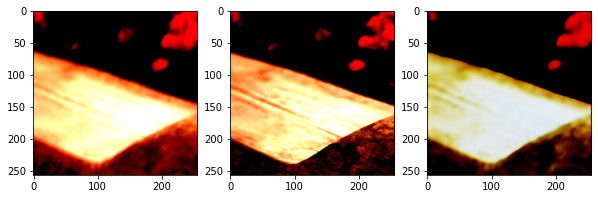

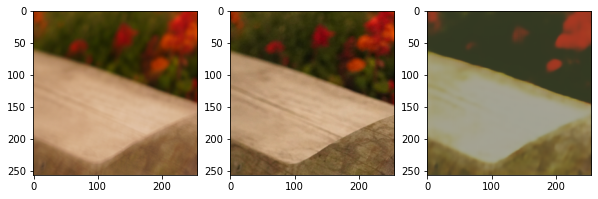

---- -2.6311284e-08 ,, 0.94117635
=====
This is epoch 33
And the PSNR is 23.111565145455405
And the images are...


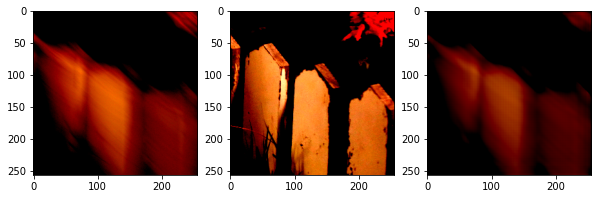

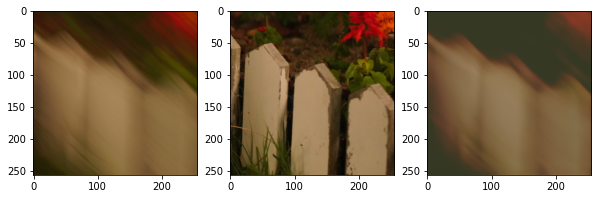

---- 0.0039215502 ,, 1.0
=====
This is epoch 34
And the PSNR is 18.33415416785247
And the images are...


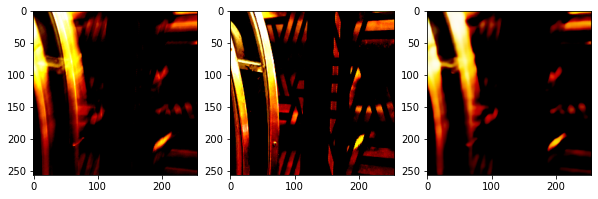

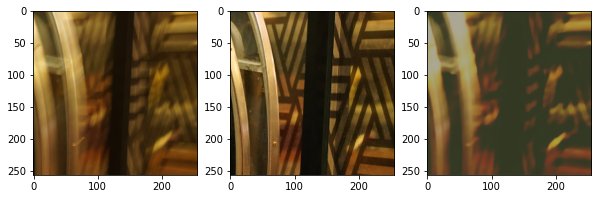

---- 0.0 ,, 0.90196073
=====
This is epoch 35
And the PSNR is 19.0755126060585
And the images are...


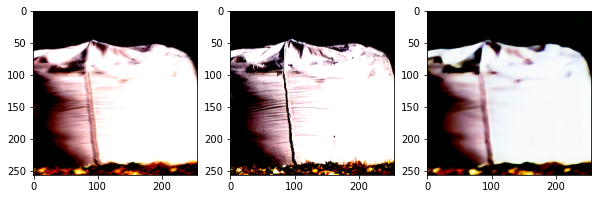

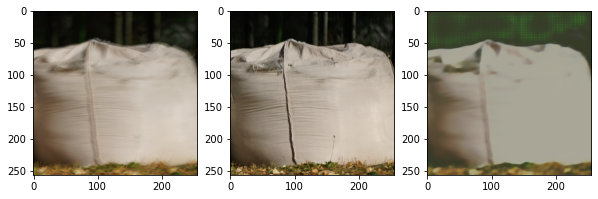

---- 0.0 ,, 0.8000001
=====
This is epoch 36
And the PSNR is 20.017343742795607
And the images are...


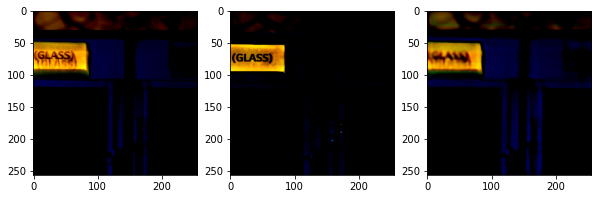

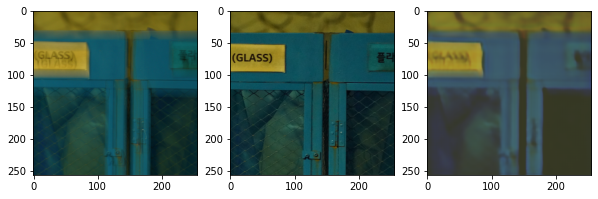

---- 0.0 ,, 0.82745093
=====
This is epoch 37
And the PSNR is 24.02446696082849
And the images are...


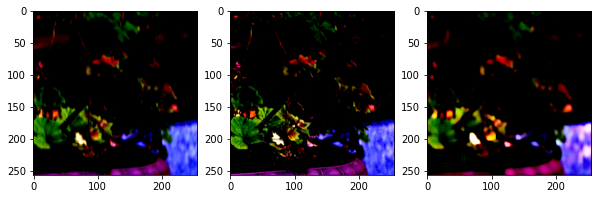

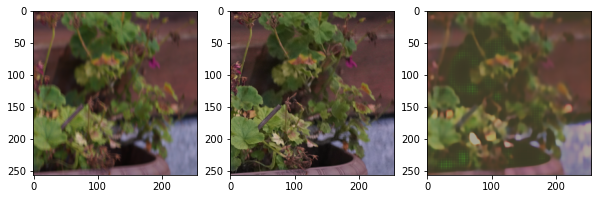

---- 0.011764705 ,, 0.9960784
=====
This is epoch 38
And the PSNR is 20.188955283877146
And the images are...


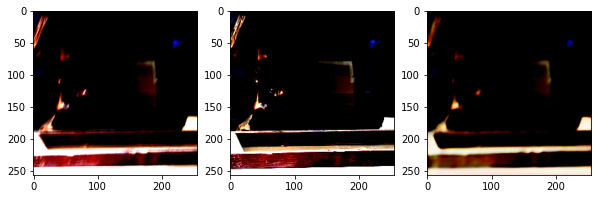

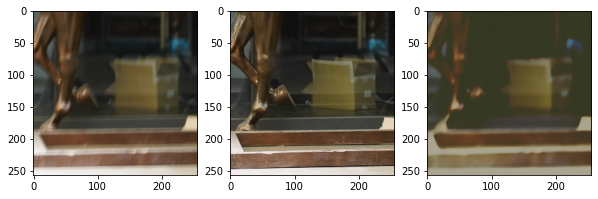

---- 0.0 ,, 0.8745098
=====
This is epoch 39
And the PSNR is 22.787342332135182
And the images are...


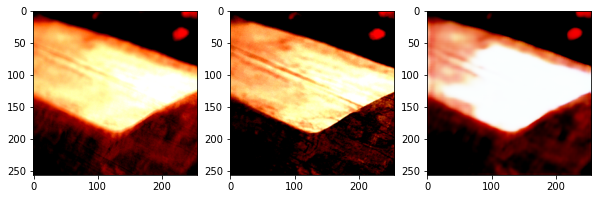

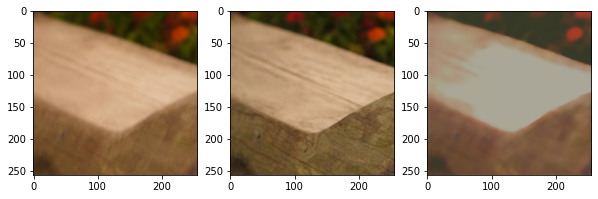

---- -2.811304e-08 ,, 0.88627446
=====
This is epoch 40
And the PSNR is 23.460075985511892
And the images are...


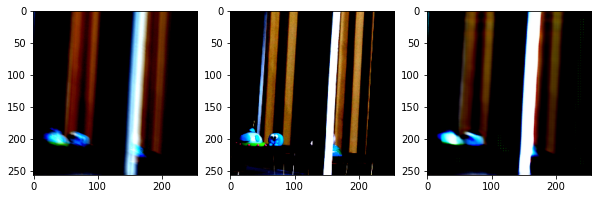

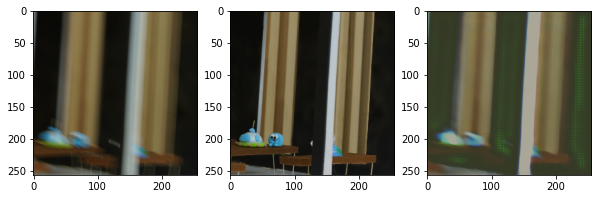

---- -2.811304e-08 ,, 1.0
=====
This is epoch 41
And the PSNR is 20.33532479176116
And the images are...


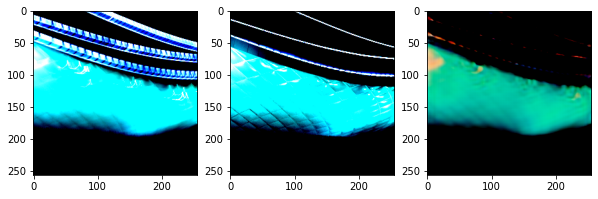

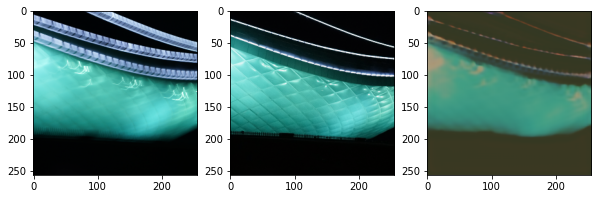

---- -2.811304e-08 ,, 0.9411765
=====
This is epoch 42
And the PSNR is 27.278012238295233
And the images are...


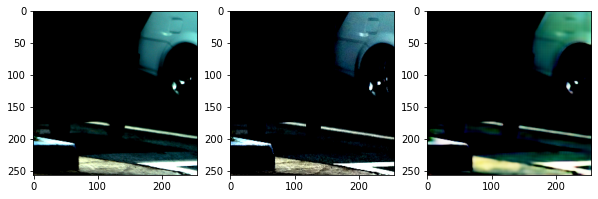

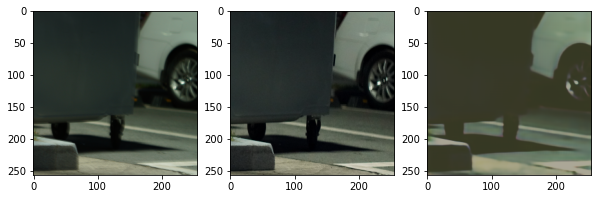

---- 0.0039215502 ,, 0.890196
=====
This is epoch 43
And the PSNR is 26.04340503766318
And the images are...


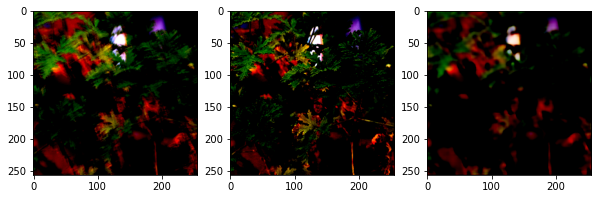

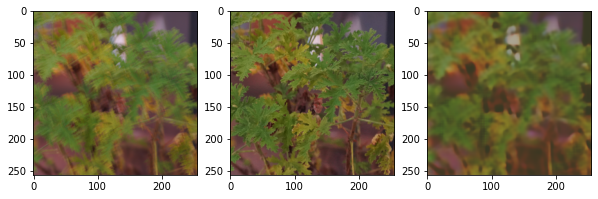

---- 0.0 ,, 1.0
=====
This is epoch 44
And the PSNR is 16.610760827357495
And the images are...


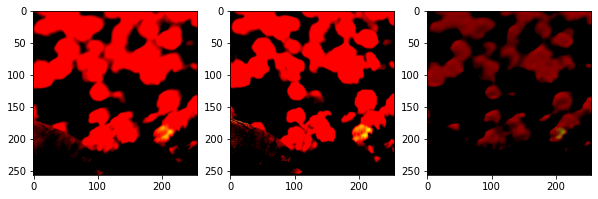

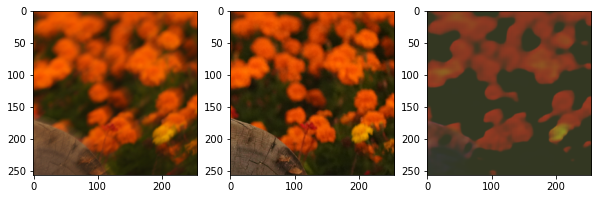

---- -2.811304e-08 ,, 0.98823524
=====
This is epoch 45
And the PSNR is 23.881734266158
And the images are...


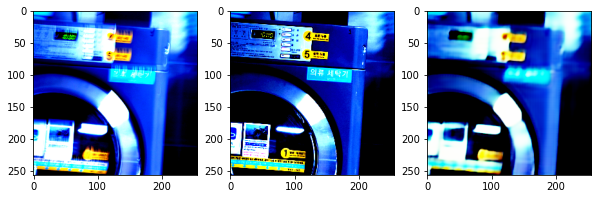

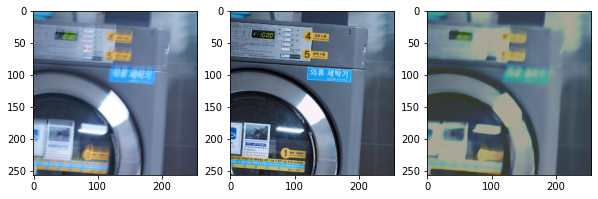

---- 0.003921544 ,, 0.9529411
=====
This is epoch 46
And the PSNR is 19.20014907860866
And the images are...


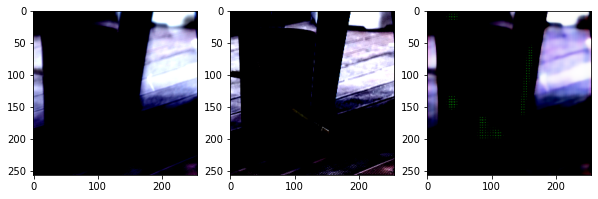

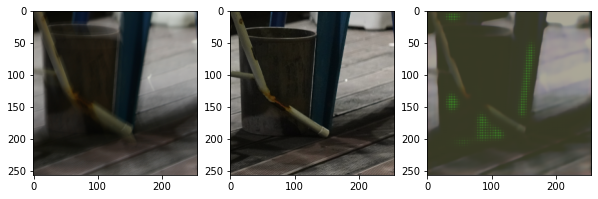

---- 0.003921544 ,, 1.0
=====
This is epoch 47
And the PSNR is 23.514090246241146
And the images are...


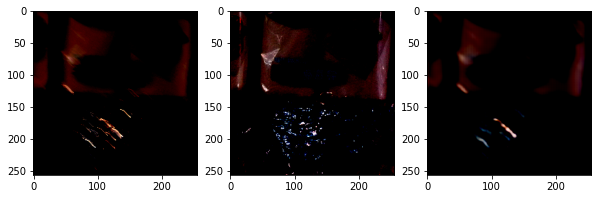

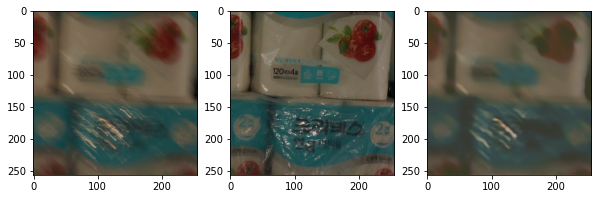

---- -2.811304e-08 ,, 0.8823529
=====
This is epoch 48
And the PSNR is 22.868142314443496
And the images are...


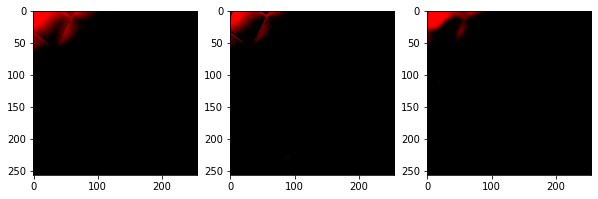

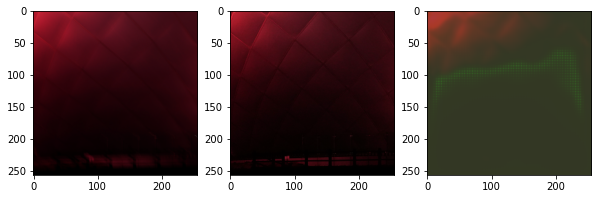

---- -2.811304e-08 ,, 1.0
=====
This is epoch 49
And the PSNR is 25.683017344803115
And the images are...


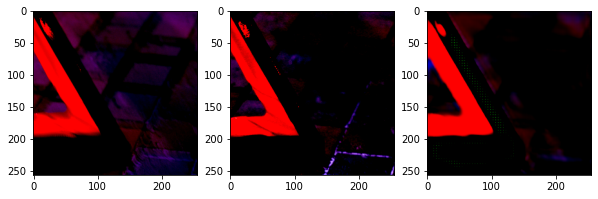

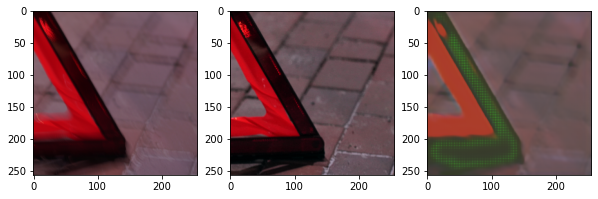

---- 0.019607807 ,, 0.9960783
=====
This is epoch 50
And the PSNR is 22.814714685808326
And the images are...


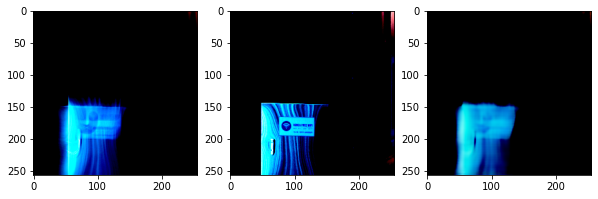

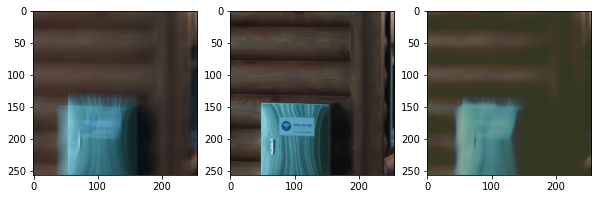

---- -2.811304e-08 ,, 1.0
=====
This is epoch 51
And the PSNR is 27.874711425816145
And the images are...


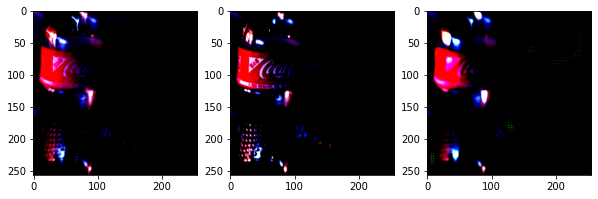

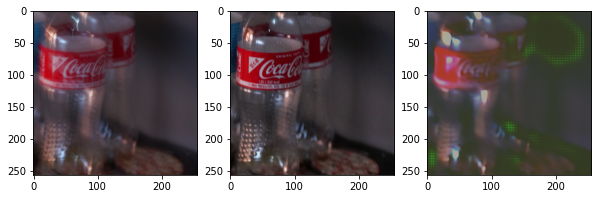

---- -2.811304e-08 ,, 1.0
=====
This is epoch 52
And the PSNR is 22.83763040773224
And the images are...


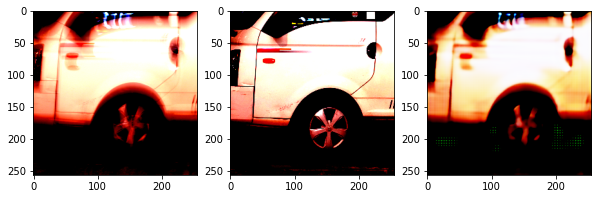

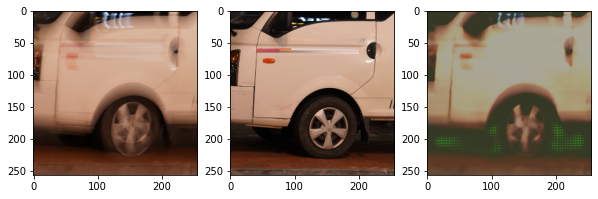

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 53
And the PSNR is 23.622944455248586
And the images are...


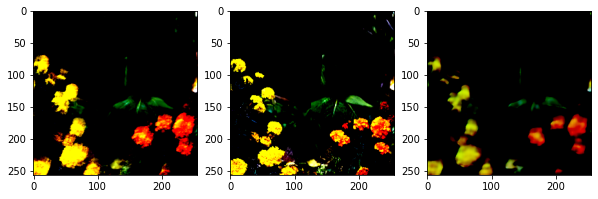

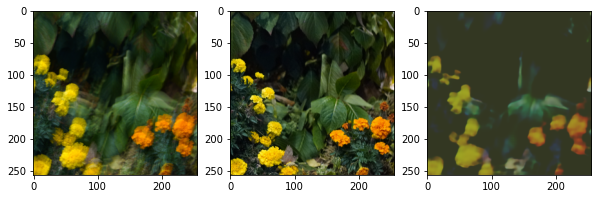

---- -2.811304e-08 ,, 0.5843137
=====
This is epoch 54
And the PSNR is 23.13171199498032
And the images are...


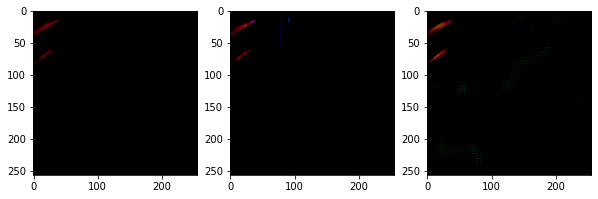

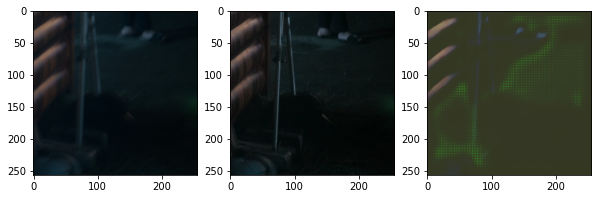

---- -2.811304e-08 ,, 0.9843136
=====
This is epoch 55
And the PSNR is 29.99769057588905
And the images are...


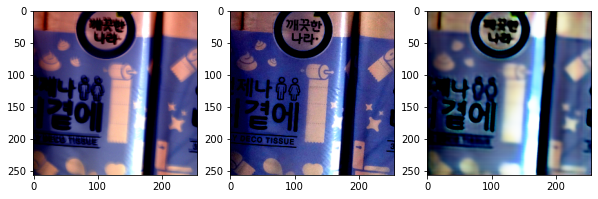

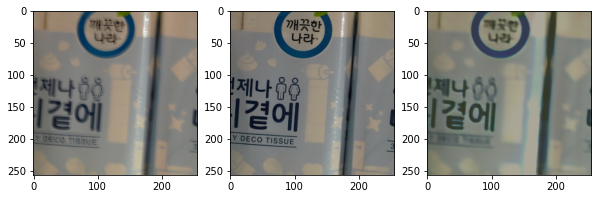

---- 0.007843117 ,, 0.9960784
=====
This is epoch 56
And the PSNR is 15.680098205444821
And the images are...


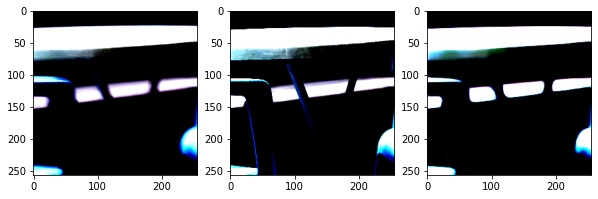

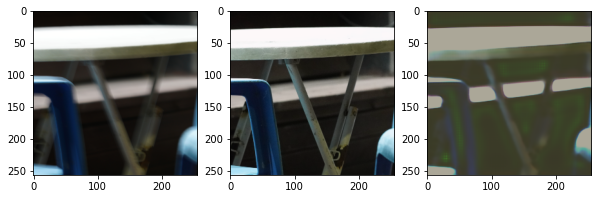

---- 0.031372525 ,, 0.8705882
=====
This is epoch 57
And the PSNR is 14.739654267312861
And the images are...


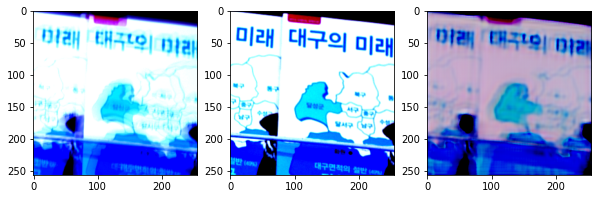

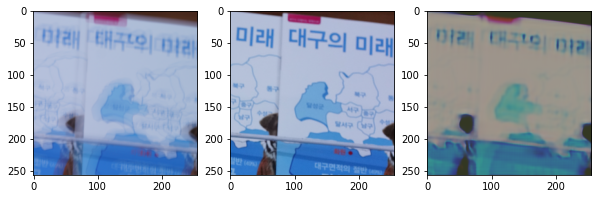

---- 0.019607807 ,, 0.7764705
=====
This is epoch 58
And the PSNR is 28.54520294277354
And the images are...


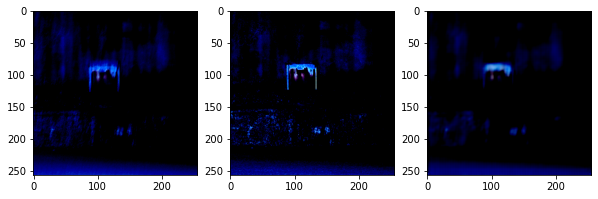

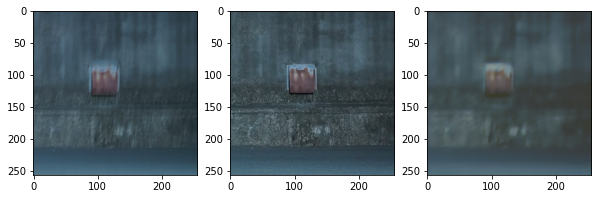

---- -2.811304e-08 ,, 0.74509805
=====
This is epoch 59
And the PSNR is 28.250561390985183
And the images are...


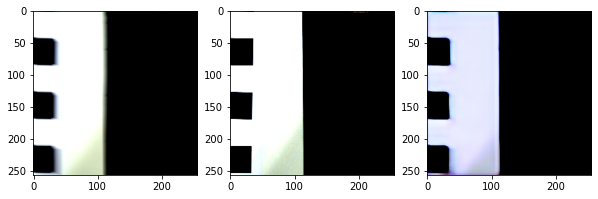

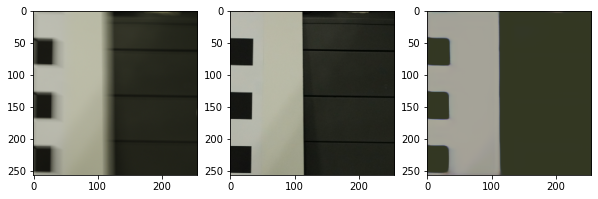

---- -2.811304e-08 ,, 1.0
=====
This is epoch 60
And the PSNR is 21.429483999380906
And the images are...


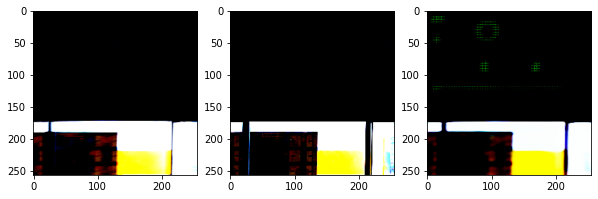

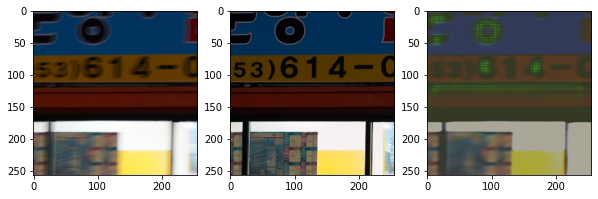

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 61
And the PSNR is 24.27051945532138
And the images are...


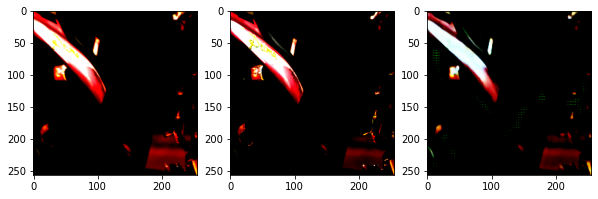

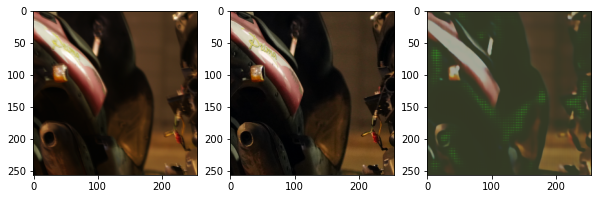

---- 0.003921544 ,, 1.0
=====
This is epoch 62
And the PSNR is 23.367613578854865
And the images are...


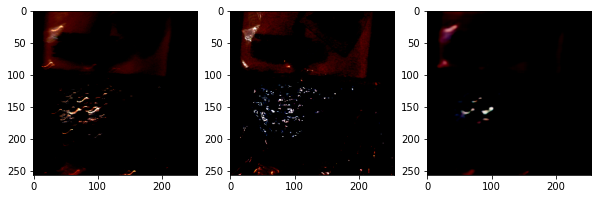

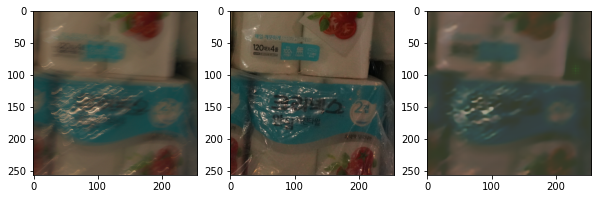

---- 0.011764705 ,, 0.78431374
=====
This is epoch 63
And the PSNR is 25.022526893429472
And the images are...


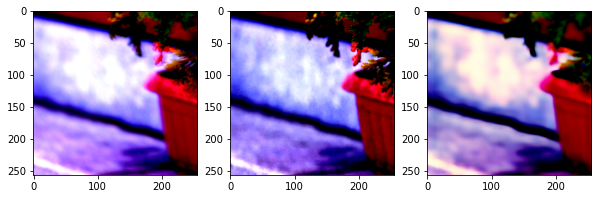

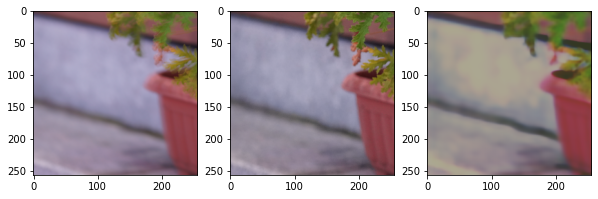

---- -2.6311284e-08 ,, 0.7411764
=====
This is epoch 64
And the PSNR is 25.653530956293864
And the images are...


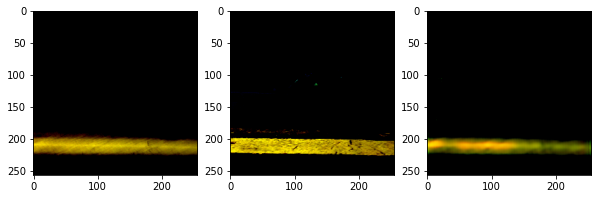

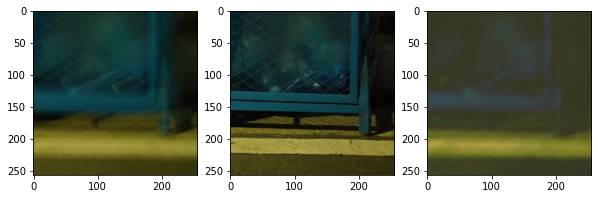

---- -2.811304e-08 ,, 1.0
=====
This is epoch 65
And the PSNR is 24.558609028304947
And the images are...


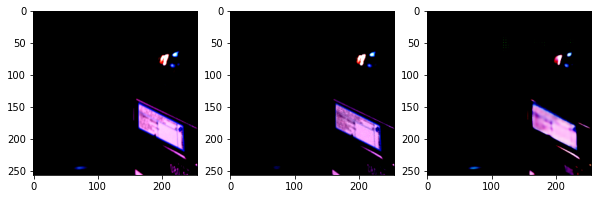

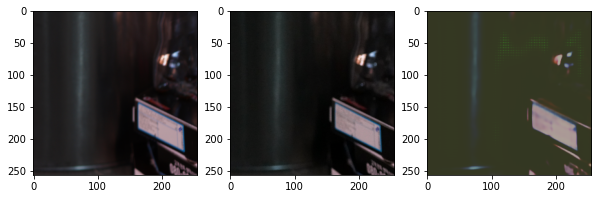

---- 0.019607807 ,, 0.8745098
=====
This is epoch 66
And the PSNR is 21.597575083678567
And the images are...


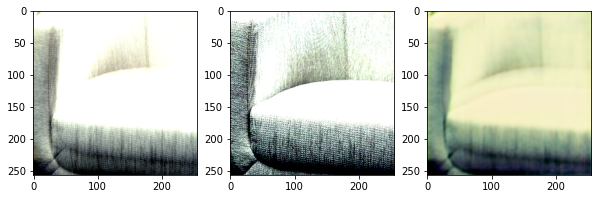

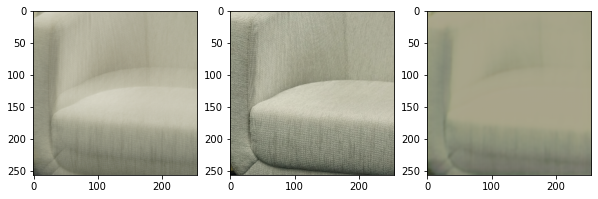

---- 0.015686262 ,, 0.8549019
=====
This is epoch 67
And the PSNR is 17.552871644154628
And the images are...


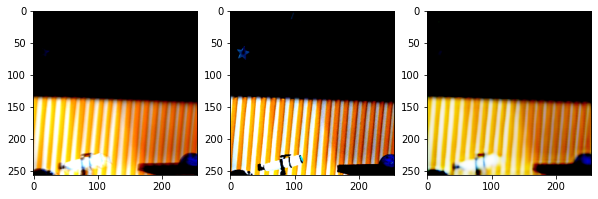

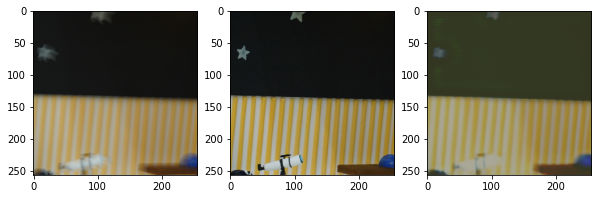

---- -2.811304e-08 ,, 1.0
=====
This is epoch 68
And the PSNR is 27.51009731619426
And the images are...


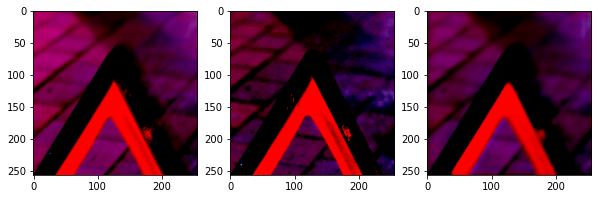

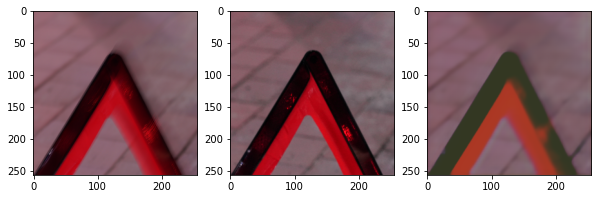

---- 0.011764705 ,, 0.6509804
=====
This is epoch 69
And the PSNR is 24.498984151610003
And the images are...


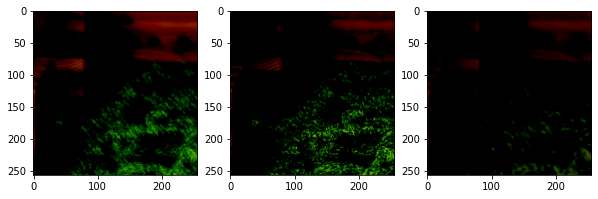

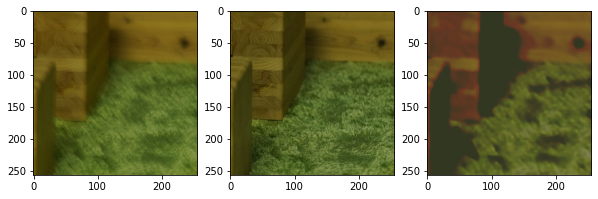

---- 0.0 ,, 1.0
=====
This is epoch 70
And the PSNR is 17.752546608855507
And the images are...


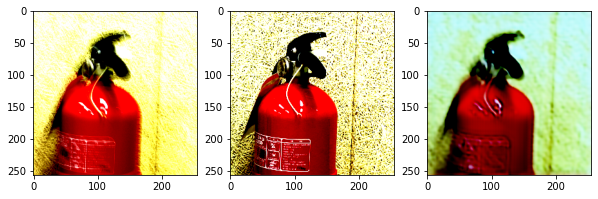

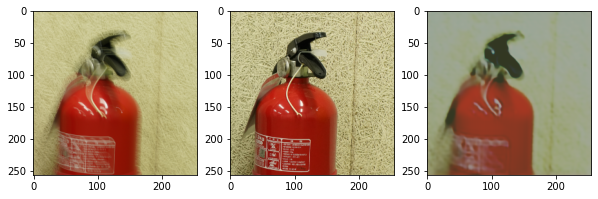

---- 0.0 ,, 0.78431374
=====
This is epoch 71
And the PSNR is 18.850219993891127
And the images are...


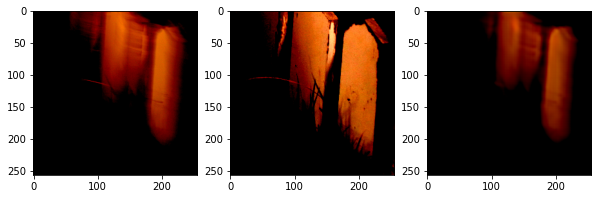

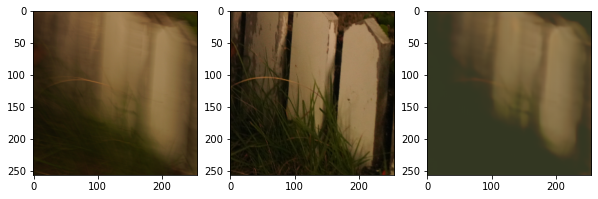

---- 0.019607833 ,, 0.6235294
=====
This is epoch 72
And the PSNR is 21.01695551762225
And the images are...


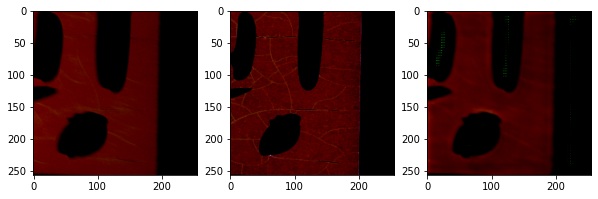

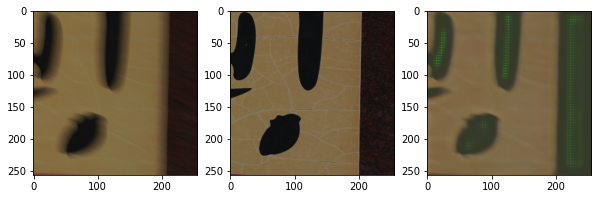

---- -2.811304e-08 ,, 1.0
=====
This is epoch 73
And the PSNR is 25.48551123291473
And the images are...


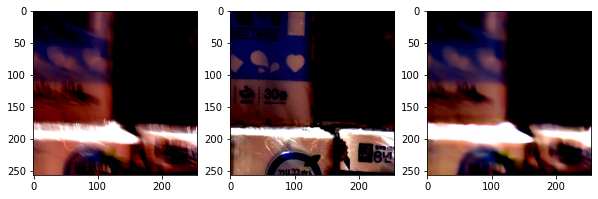

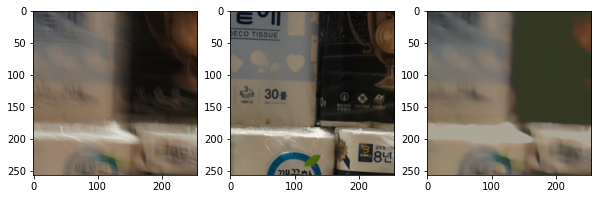

---- 0.0 ,, 0.74901956
=====
This is epoch 74
And the PSNR is 24.74705063049218
And the images are...


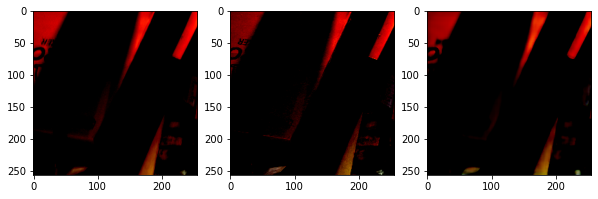

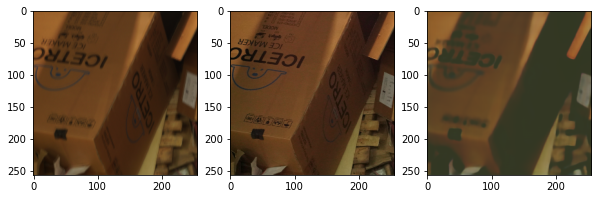

---- -2.811304e-08 ,, 0.75294113
=====
This is epoch 75
And the PSNR is 28.18238656865188
And the images are...


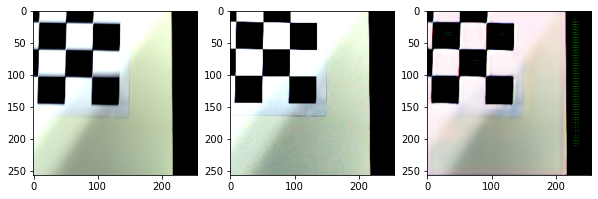

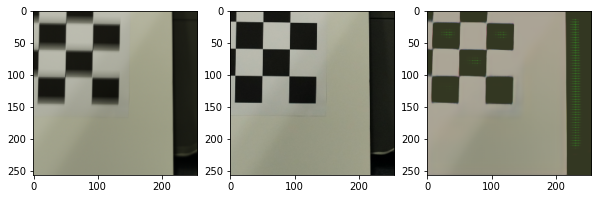

---- 0.02352941 ,, 0.63529414
=====
This is epoch 76
And the PSNR is 24.50157390499904
And the images are...


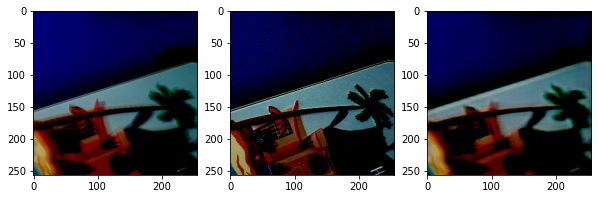

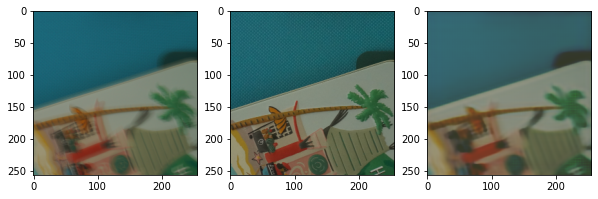

---- 0.015686262 ,, 0.5568627
=====
This is epoch 77
And the PSNR is 28.28316683312242
And the images are...


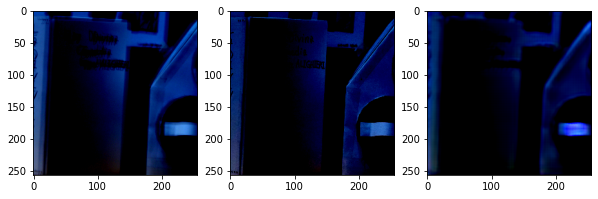

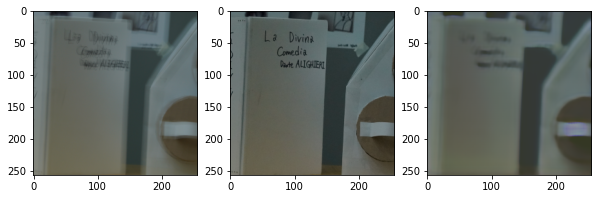

---- 0.003921544 ,, 0.980392
=====
This is epoch 78
And the PSNR is 16.83453328631954
And the images are...


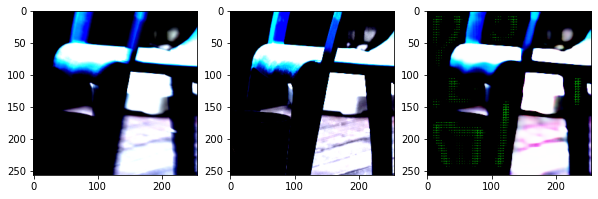

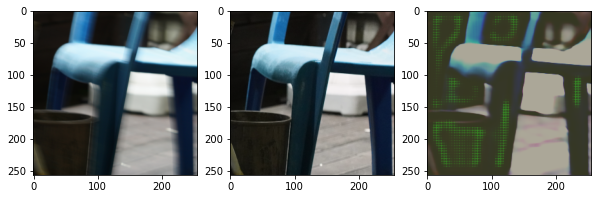

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 79
And the PSNR is 24.253941732452
And the images are...


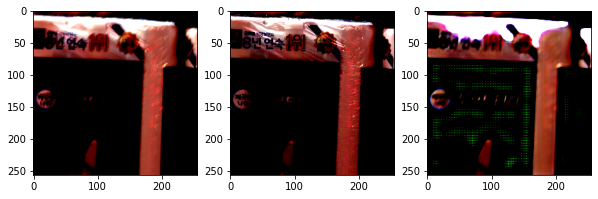

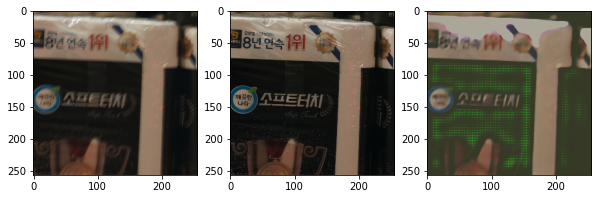

---- 0.011764705 ,, 0.6470588
=====
This is epoch 80
And the PSNR is 25.797730287261032
And the images are...


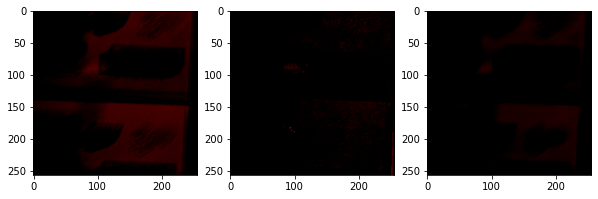

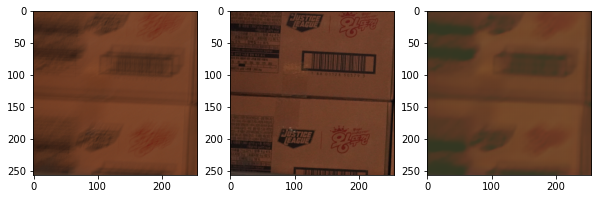

---- 0.035294116 ,, 0.9686274
=====
This is epoch 81
And the PSNR is 23.471123635632942
And the images are...


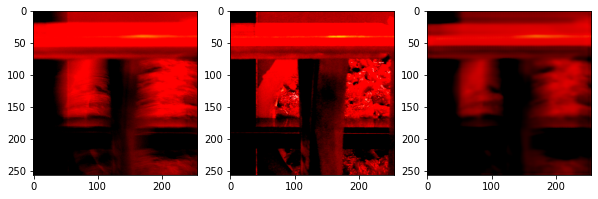

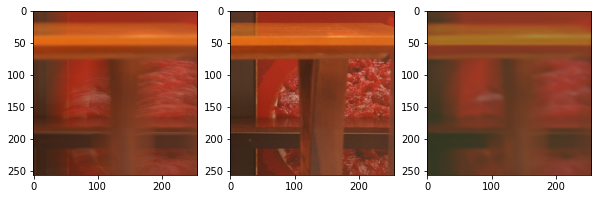

---- 0.0 ,, 1.0
=====
This is epoch 82
And the PSNR is 19.327999642824867
And the images are...


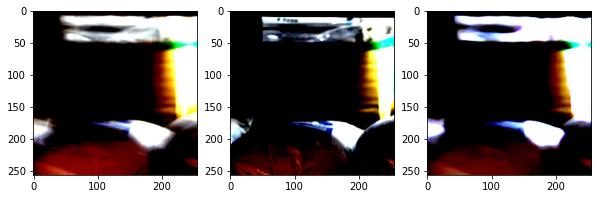

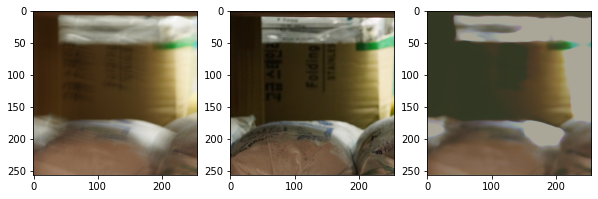

---- -2.811304e-08 ,, 0.99215686
=====
This is epoch 83
And the PSNR is 23.263301651636723
And the images are...


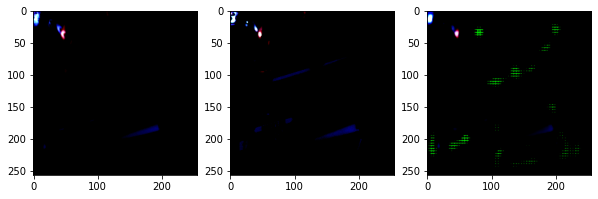

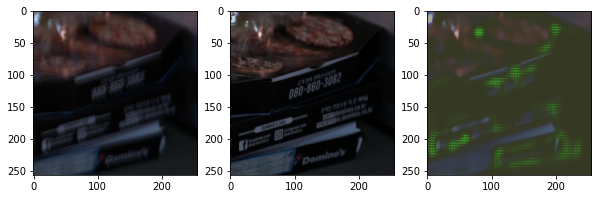

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 84
And the PSNR is 24.215779311470754
And the images are...


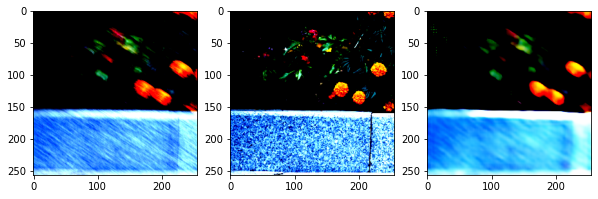

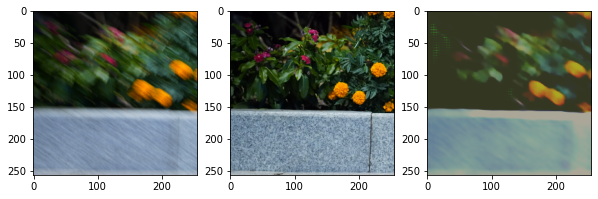

---- 0.043137245 ,, 0.98823524
=====
This is epoch 85
And the PSNR is 18.442269103953112
And the images are...


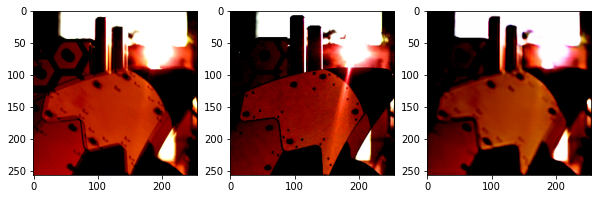

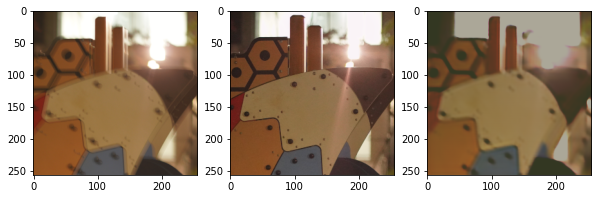

---- 0.0 ,, 1.0
=====
This is epoch 86
And the PSNR is 23.84629697095275
And the images are...


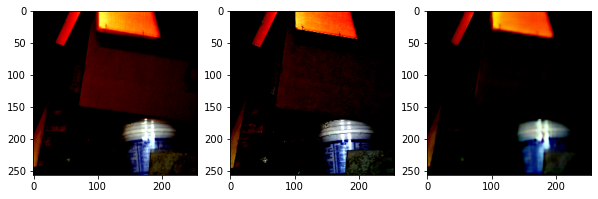

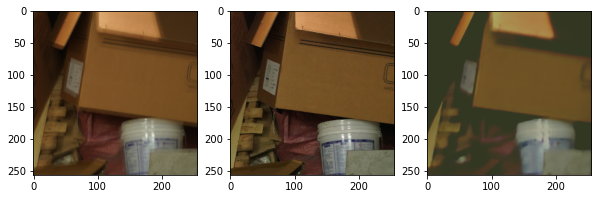

---- 0.0 ,, 0.8588235
=====
This is epoch 87
And the PSNR is 26.459937072866797
And the images are...


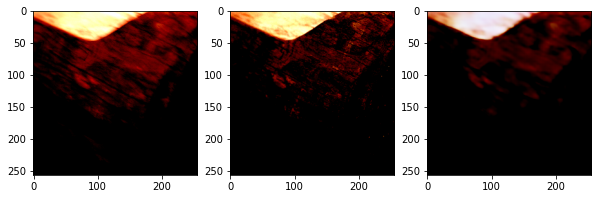

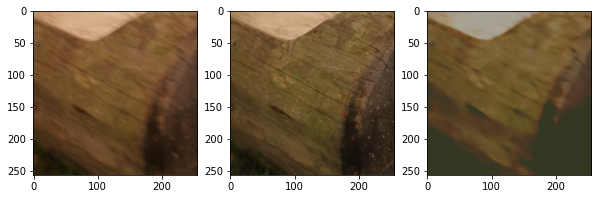

---- -2.811304e-08 ,, 1.0
=====
This is epoch 88
And the PSNR is 21.63541877895721
And the images are...


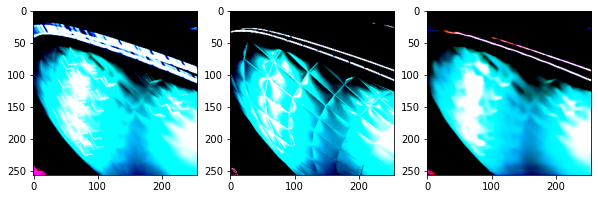

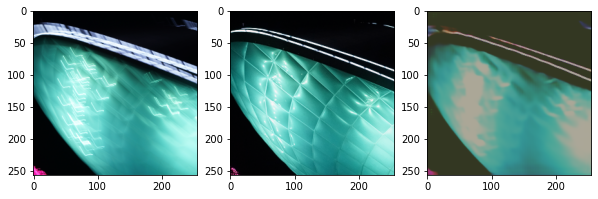

---- -2.811304e-08 ,, 1.0
=====
This is epoch 89
And the PSNR is 26.48703992553815
And the images are...


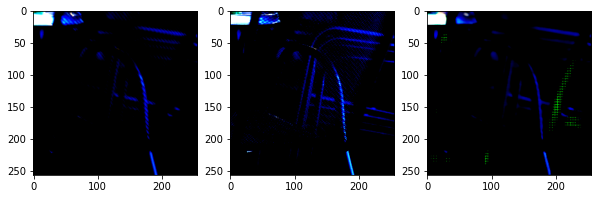

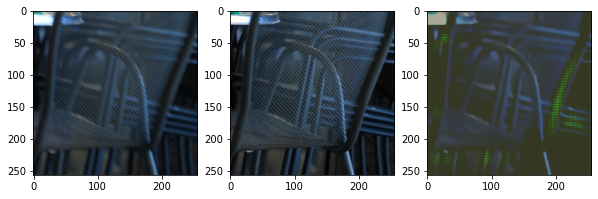

---- -2.811304e-08 ,, 0.6666666
=====
This is epoch 90
And the PSNR is 28.737505086964532
And the images are...


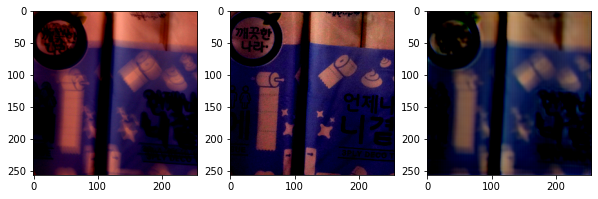

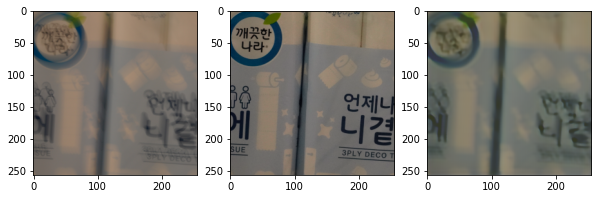

---- -2.811304e-08 ,, 1.0
=====
This is epoch 91
And the PSNR is 25.48071508904585
And the images are...


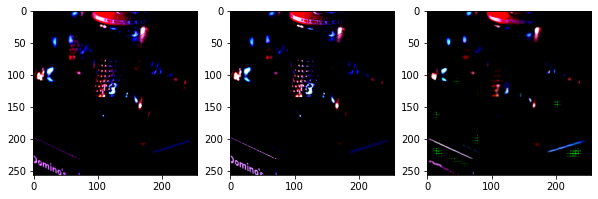

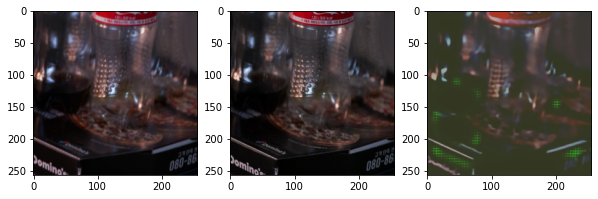

---- 0.035294097 ,, 0.7647059
=====
This is epoch 92
And the PSNR is 16.196604920899922
And the images are...


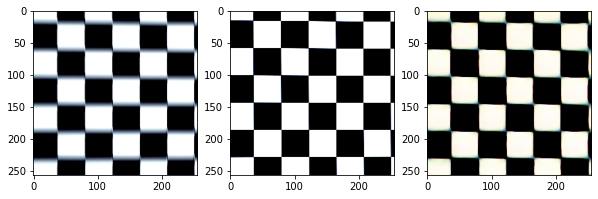

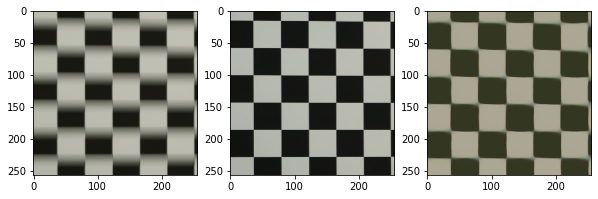

---- -2.811304e-08 ,, 0.6666667
=====
This is epoch 93
And the PSNR is 33.80674624053594
And the images are...


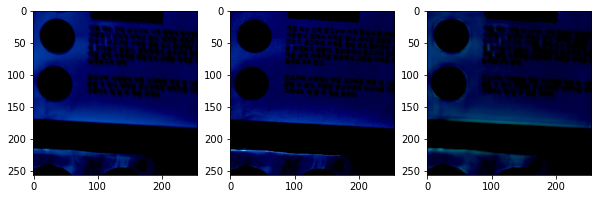

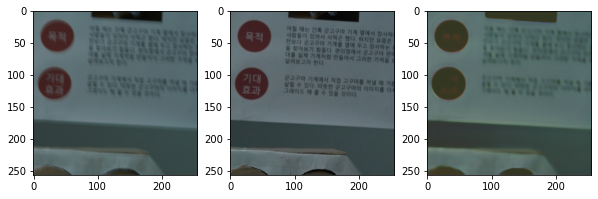

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 94
And the PSNR is 28.653606879156573
And the images are...


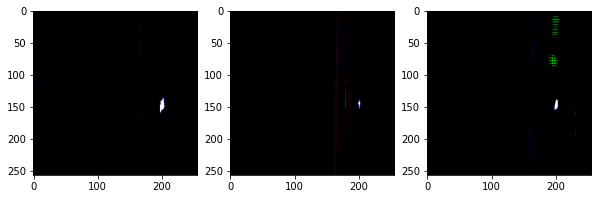

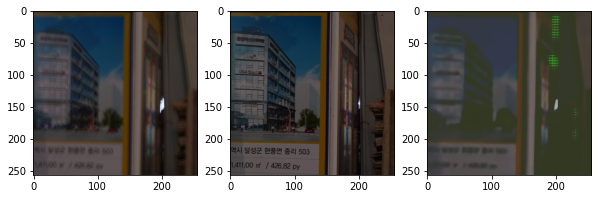

---- -2.811304e-08 ,, 0.90588224
=====
This is epoch 95
And the PSNR is 27.781858286221205
And the images are...


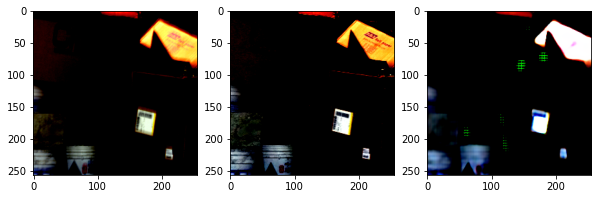

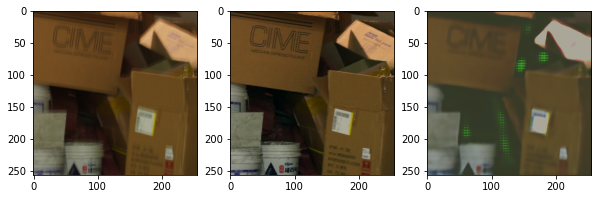

---- 0.031372525 ,, 0.8705882
=====
This is epoch 96
And the PSNR is 16.460052272222363
And the images are...


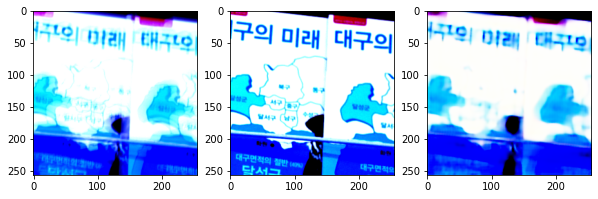

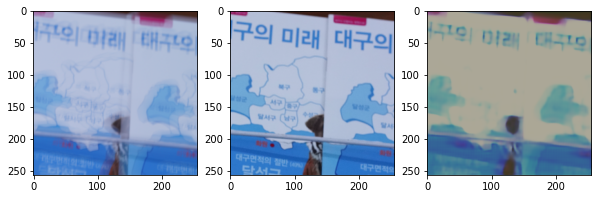

---- 0.027450962 ,, 0.47843134
=====
This is epoch 97
And the PSNR is 26.17098505036803
And the images are...


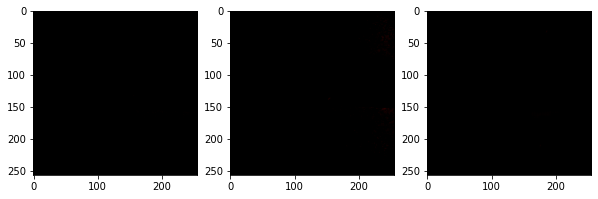

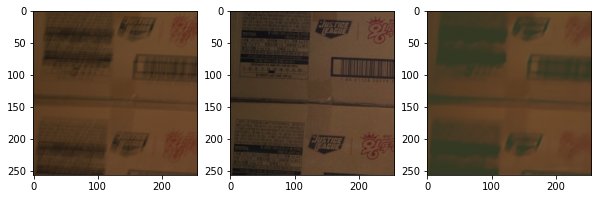

---- -2.6311284e-08 ,, 0.7176471
=====
This is epoch 98
And the PSNR is 25.0907859439156
And the images are...


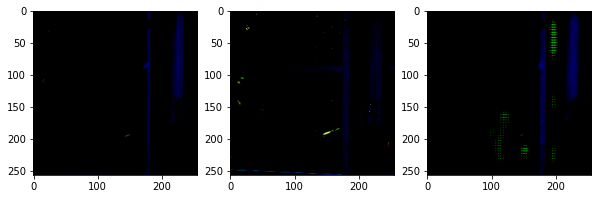

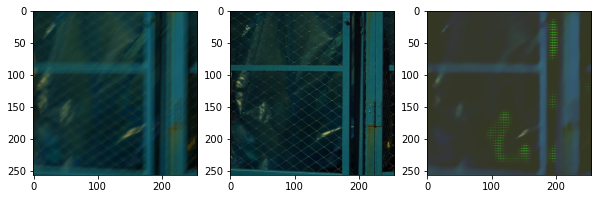

---- -2.811304e-08 ,, 1.0
=====
This is epoch 99
And the PSNR is 21.68091947912183
And the images are...


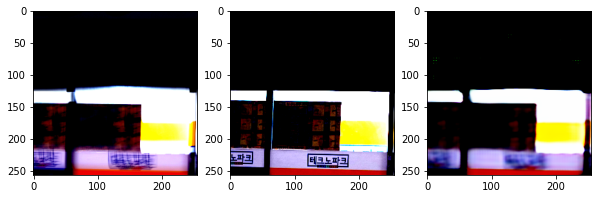

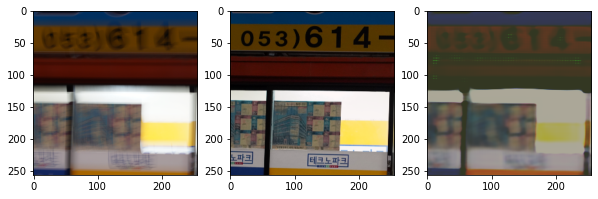

---- 0.003921544 ,, 1.0
=====
This is epoch 100
And the PSNR is 18.02162905296447
And the images are...


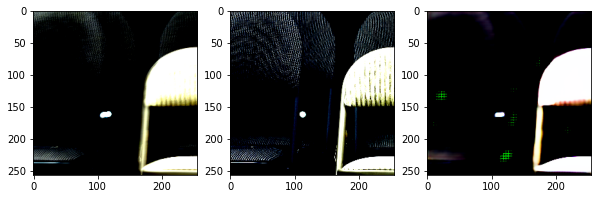

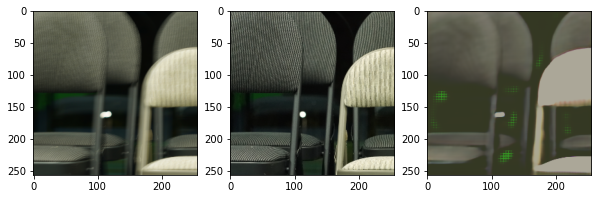

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 101
And the PSNR is 27.6387332869746
And the images are...


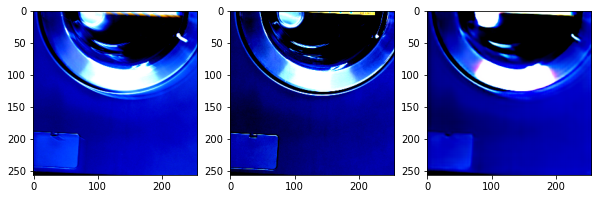

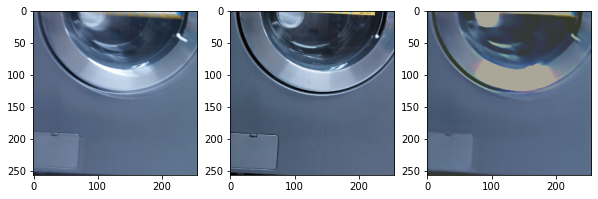

---- -2.811304e-08 ,, 0.8039216
=====
This is epoch 102
And the PSNR is 30.351316660909333
And the images are...


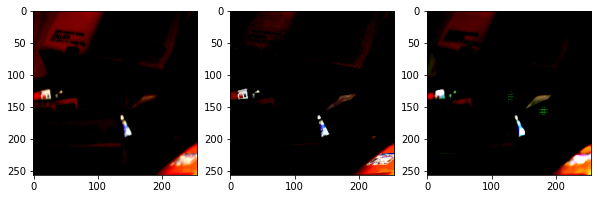

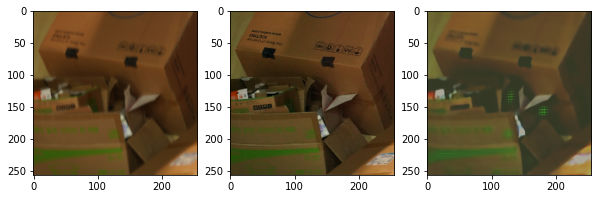

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 103
And the PSNR is 28.0185238632048
And the images are...


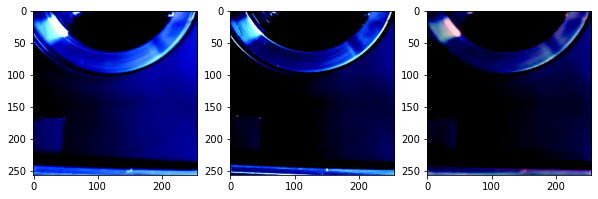

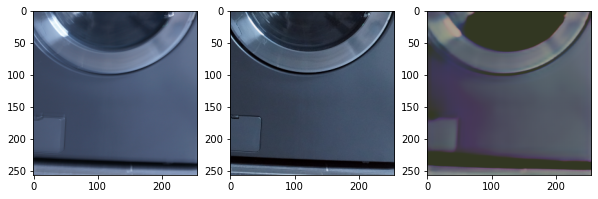

---- -2.811304e-08 ,, 0.8509803
=====
This is epoch 104
And the PSNR is 26.61476936104116
And the images are...


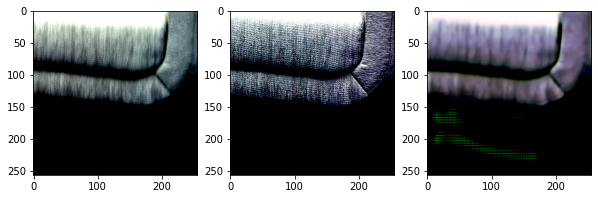

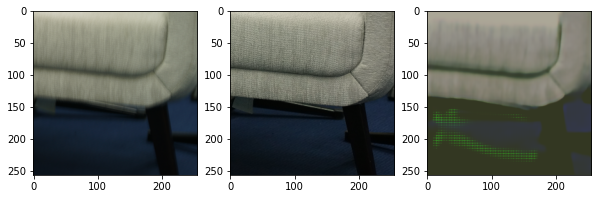

---- 0.0 ,, 0.52941173
=====
This is epoch 105
And the PSNR is 22.557361878802737
And the images are...


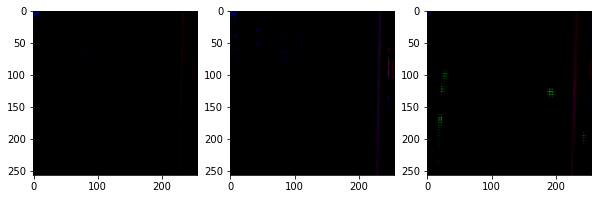

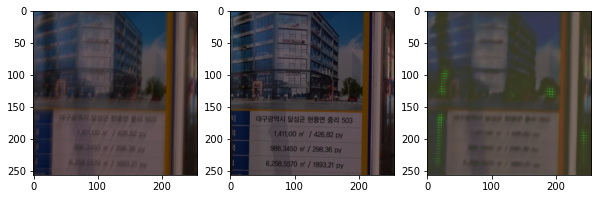

---- 0.015686255 ,, 0.6705882
=====
This is epoch 106
And the PSNR is 20.557548374981188
And the images are...


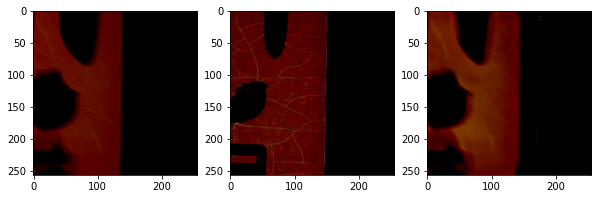

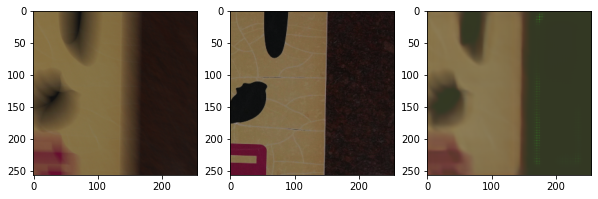

---- -2.811304e-08 ,, 0.9843136
=====
This is epoch 107
And the PSNR is 24.692134527552433
And the images are...


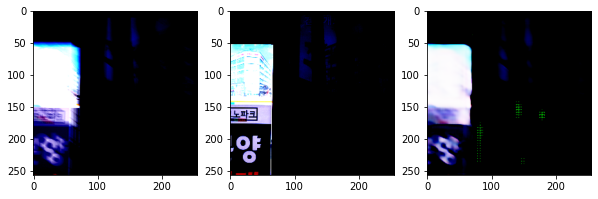

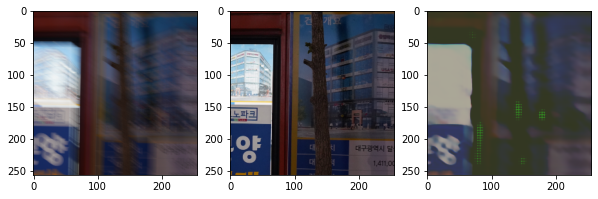

---- 0.019607825 ,, 0.96470577
=====
This is epoch 108
And the PSNR is 20.513459891896424
And the images are...


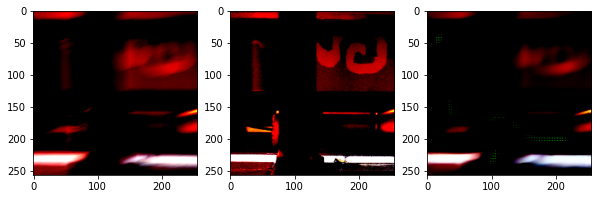

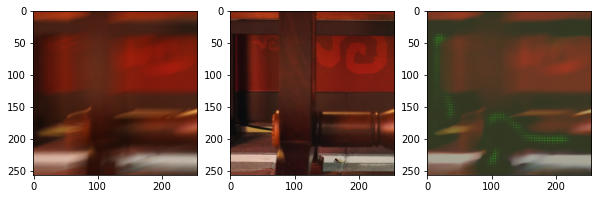

---- 0.05098036 ,, 0.917647
=====
This is epoch 109
And the PSNR is 17.929125687939262
And the images are...


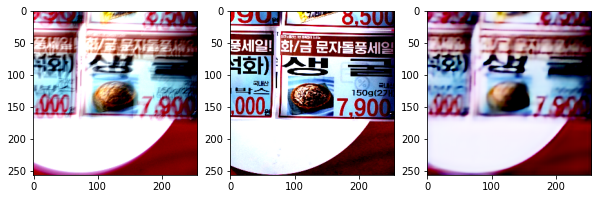

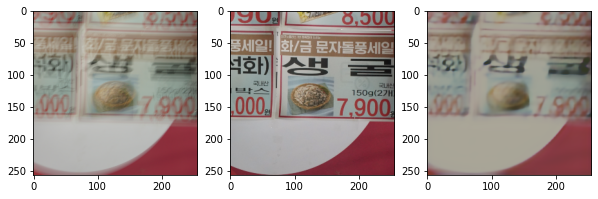

---- -2.811304e-08 ,, 1.0
=====
This is epoch 110
And the PSNR is 27.51250927557463
And the images are...


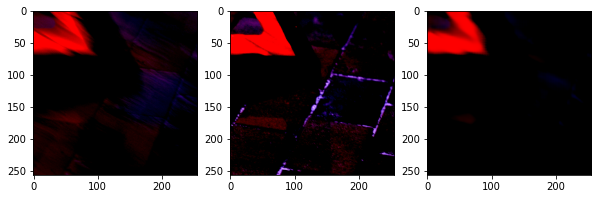

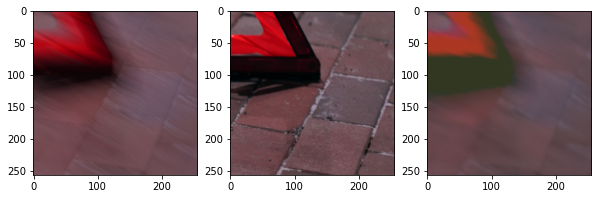

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 111
And the PSNR is 26.854973348226583
And the images are...


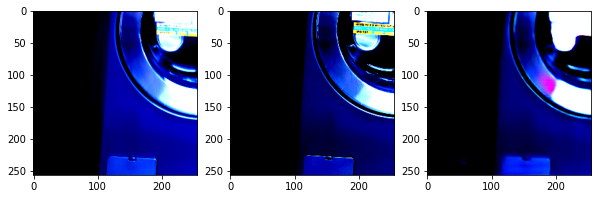

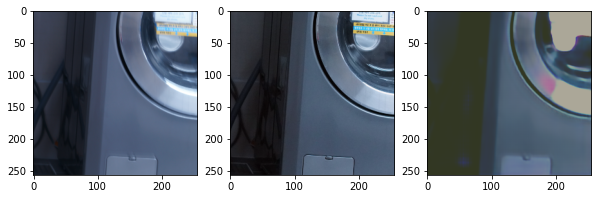

---- -2.811304e-08 ,, 1.0
=====
This is epoch 112
And the PSNR is 26.14027197761282
And the images are...


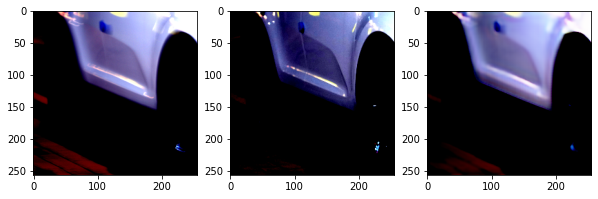

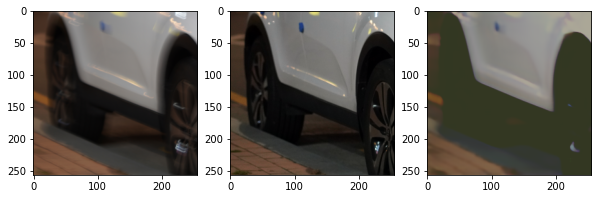

---- 0.015686262 ,, 0.9960783
=====
This is epoch 113
And the PSNR is 22.84414310437977
And the images are...


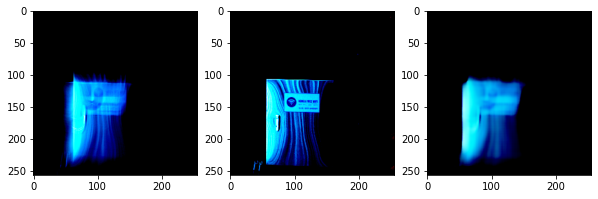

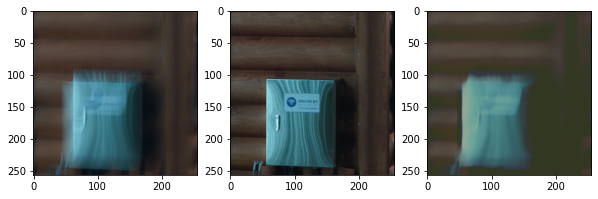

---- -2.811304e-08 ,, 0.7686274
=====
This is epoch 114
And the PSNR is 28.98020348460745
And the images are...


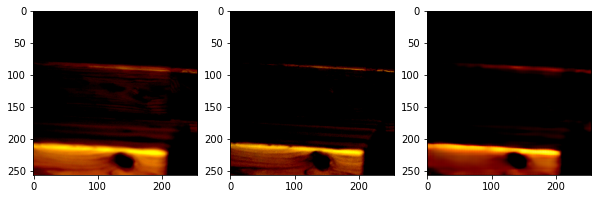

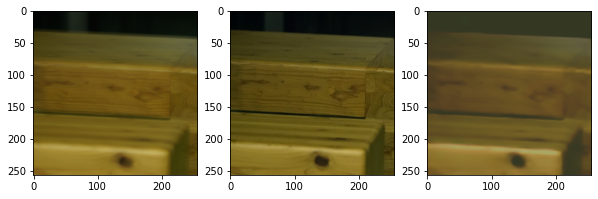

---- -2.811304e-08 ,, 0.89411765
=====
This is epoch 115
And the PSNR is 21.1071589553398
And the images are...


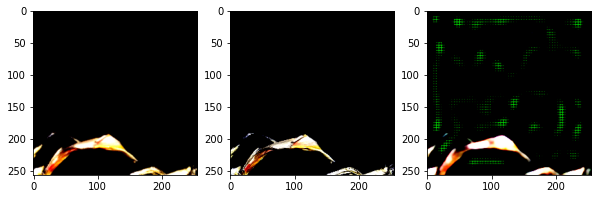

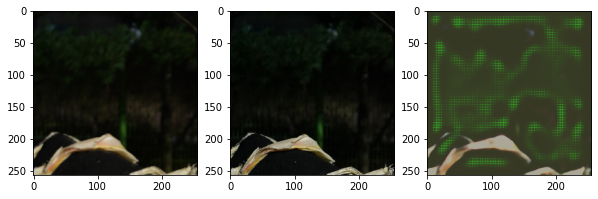

---- -2.811304e-08 ,, 1.0
=====
This is epoch 116
And the PSNR is 25.1874828148556
And the images are...


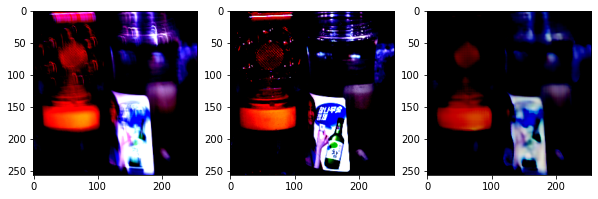

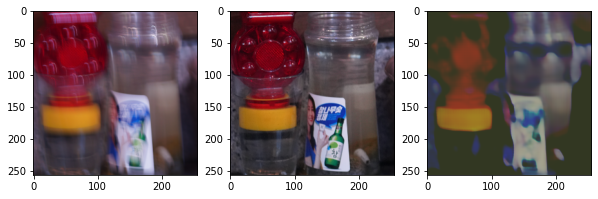

---- -2.811304e-08 ,, 0.67843133
=====
This is epoch 117
And the PSNR is 27.85452009466441
And the images are...


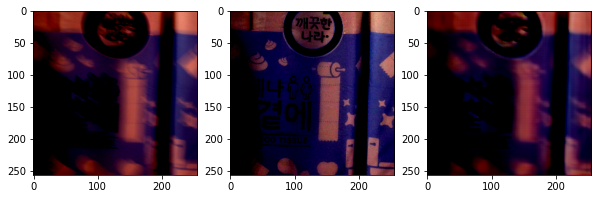

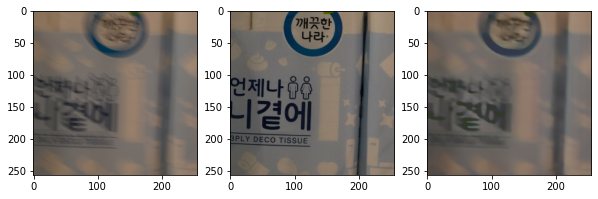

---- 0.007843117 ,, 0.98823524
=====
This is epoch 118
And the PSNR is 23.59956396270124
And the images are...


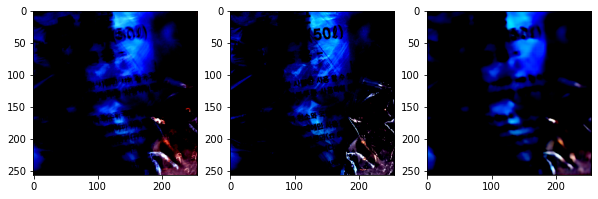

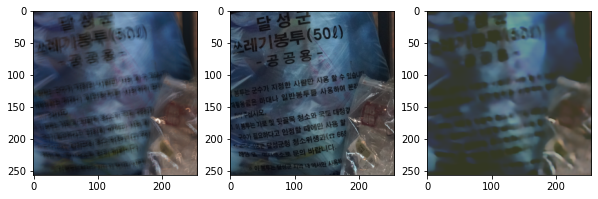

---- 0.0 ,, 0.8000001
=====
This is epoch 119
And the PSNR is 21.422066733411715
And the images are...


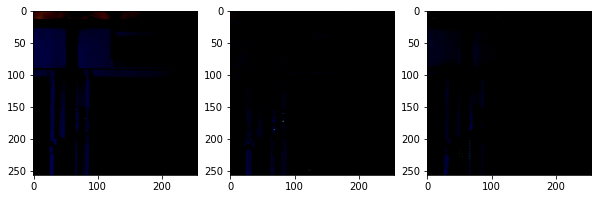

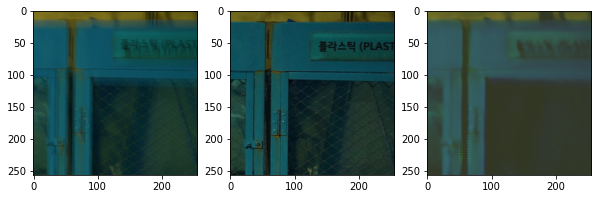

---- -2.811304e-08 ,, 0.87058824
=====
This is epoch 120
And the PSNR is 28.64843456539071
And the images are...


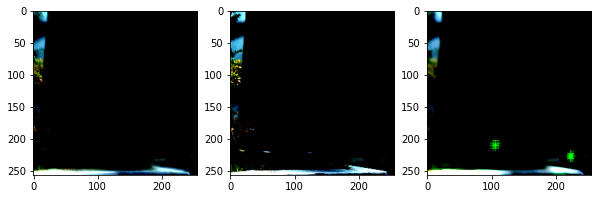

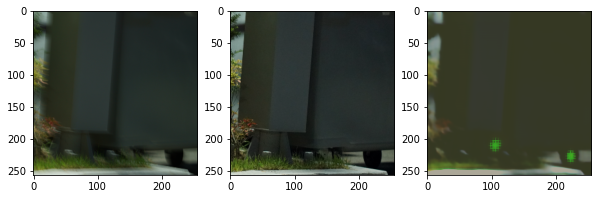

---- 0.0078431275 ,, 0.9921568
=====
This is epoch 121
And the PSNR is 18.723749855171878
And the images are...


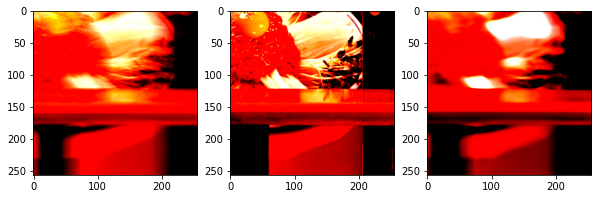

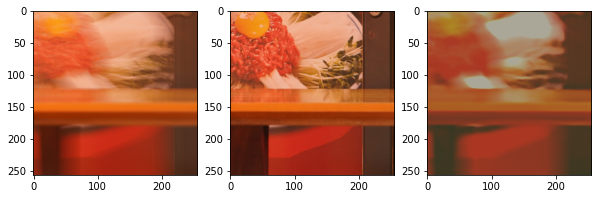

---- -2.811304e-08 ,, 0.97647053
=====
This is epoch 122
And the PSNR is 24.379489974926678
And the images are...


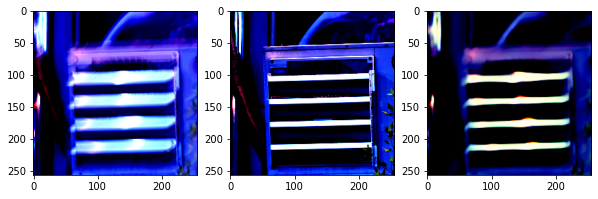

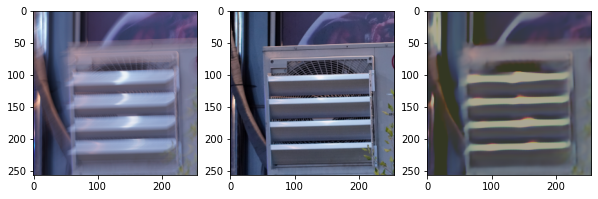

---- -2.811304e-08 ,, 1.0
=====
This is epoch 123
And the PSNR is 19.90425489317573
And the images are...


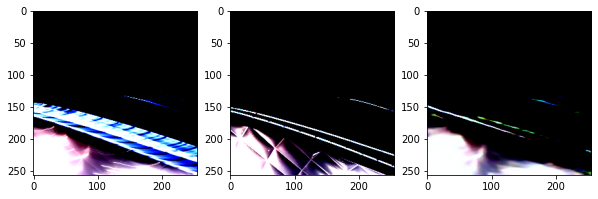

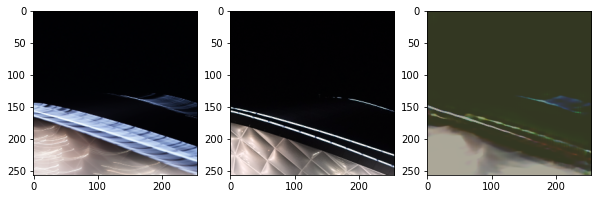

In [ ]:
# dataset = BSD_B_Dataset(path, target_size=target_size)
# dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
datamodule = BSD_B_DataModule(batch_size=batch_size, target_size=target_size, mean=mean, std=std)

pix2pix = Pix2Pix(3, 3, learning_rate=lr, lambda_recon=lambda_recon, display_step=display_step, mean=mean, std=std)
trainer = pl.Trainer(max_epochs=n_epochs, gpus=1, callbacks=[checkpoint_callback])   # REMEMBER THE GPU
# trainer.fit(pix2pix, dataloader)
trainer.fit(pix2pix, datamodule)